# Import Event Data and Libraries

In [2]:
# Install Pm4PY
!pip install pm4py

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.8 MB 18.2 MB/s 
  Created wheel for pyvis: filename=pyvis-0.2.1-py3-none-any.whl size=23688 sha256=33c2cfb59e9c382253d6c19e6e4012f889ef89d731748c8f21b2684634e3c35b
  Stored in directory: /root/.cache/pip/wheels/2a/8f/04/6340d46afc74f59cc857a594ca1a2a14a1f4cbd4fd6c2e9306
  Created wheel for stringdist: filename=StringDist-1.0.9-cp37-cp37m-linux_x86_64.whl size=23599 sha256=9d9f2e42235dc6d4e9af991a0d03c64f47823f7bb97613231c8d738f923a1905
  Stored in directory: /root/.cache/pip/wheels/d7/9c/d4/63bc3d8931de0980b9e4a724dea290bb40b8b1b2bd6227c8da
Successfully built pyvis stringdist


In [3]:
# Import libraries
import pm4py
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math

# Handling event log
from pm4py.objects.log.util import dataframe_utils
from pm4py.objects.conversion.log import converter as log_converter
from pm4py.objects.log.importer.xes import importer as xes_importer

# For variant analysis
from pm4py.algo.filtering.log.variants import variants_filter
from pm4py.statistics.traces.generic.log import case_statistics


# For process discovery
from pm4py.visualization.petrinet import visualizer as pn_visualizer
from pm4py.algo.discovery.alpha import algorithm as alpha_miner
from pm4py.objects.petri_net.importer import importer as pnml_importer
from pm4py.algo.evaluation.simplicity import algorithm as simplicity_evaluator
from pm4py.algo.evaluation.generalization import algorithm as generalization_evaluator
from pm4py.algo.evaluation.precision import algorithm as precision_evaluator
from pm4py.algo.evaluation.replay_fitness import algorithm as replay_fitness_evaluator
from pm4py.objects.conversion.process_tree import converter as pt_converter
from pm4py.visualization.process_tree import visualizer as pt_visualizer
from pm4py.algo.discovery.inductive import algorithm as inductive_miner
from pm4py.visualization.heuristics_net import visualizer as hn_visualizer
from pm4py.algo.discovery.heuristics import algorithm as heuristics_miner
from pm4py.algo.discovery.dfg import algorithm as dfg_discovery
from pm4py.visualization.dfg import visualizer as dfg_visualization




/usr/local/lib/python3.7/dist-packages/pm4py/visualization/petrinet/__init__.py:20: UserWarning: please use the pm4py.visualization.petri_net package instead
  warnings.warn("please use the pm4py.visualization.petri_net package instead")


In [4]:
# Import XES log
log = xes_importer.apply('/content/financial_log.xes')

parsing log, completed traces ::   0%|          | 0/13087 [00:00<?, ?it/s]

In [5]:
# Printing the first trace
log[0]

{'attributes': {'REG_DATE': datetime.datetime(2011, 10, 1, 0, 38, 44, 546000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200))), 'concept:name': '173688', 'AMOUNT_REQ': '20000'}, 'events': [{'org:resource': '112', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'A_SUBMITTED', 'time:timestamp': datetime.datetime(2011, 10, 1, 0, 38, 44, 546000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200)))}, '..', {'org:resource': '10629', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'W_Valideren aanvraag', 'time:timestamp': datetime.datetime(2011, 10, 13, 10, 37, 37, 26000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200)))}]}

In [6]:
## printing the first event in first trace
log[0][0]  


{'org:resource': '112', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'A_SUBMITTED', 'time:timestamp': datetime.datetime(2011, 10, 1, 0, 38, 44, 546000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200)))}

In [7]:
# Show the log
log

[{'attributes': {'REG_DATE': datetime.datetime(2011, 10, 1, 0, 38, 44, 546000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200))), 'concept:name': '173688', 'AMOUNT_REQ': '20000'}, 'events': [{'org:resource': '112', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'A_SUBMITTED', 'time:timestamp': datetime.datetime(2011, 10, 1, 0, 38, 44, 546000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200)))}, '..', {'org:resource': '10629', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'W_Valideren aanvraag', 'time:timestamp': datetime.datetime(2011, 10, 13, 10, 37, 37, 26000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200)))}]}, '....', {'attributes': {'REG_DATE': datetime.datetime(2012, 2, 29, 23, 51, 16, 799000, tzinfo=datetime.timezone(datetime.timedelta(seconds=3600))), 'concept:name': '214376', 'AMOUNT_REQ': '15000'}, 'events': [{'org:resource': '112', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'A_SUBMITTED', 'time:timestamp': datetime.datetime(2

In [8]:
# Number of events
len(log)

13087

In [9]:
log_df = pm4py.convert_to_dataframe(log)

In [10]:
log_df

,org:resource,lifecycle:transition,concept:name,time:timestamp,case:REG_DATE,case:concept:name,case:AMOUNT_REQ
0,112,COMPLETE,A_SUBMITTED,2011-10-01 00:38:44.546000+02:00,2011-10-01 00:38:44.546000+02:00,173688,20000
1,112,COMPLETE,A_PARTLYSUBMITTED,2011-10-01 00:38:44.880000+02:00,2011-10-01 00:38:44.546000+02:00,173688,20000
2,112,COMPLETE,A_PREACCEPTED,2011-10-01 00:39:37.906000+02:00,2011-10-01 00:38:44.546000+02:00,173688,20000
3,112,SCHEDULE,W_Completeren aanvraag,2011-10-01 00:39:38.875000+02:00,2011-10-01 00:38:44.546000+02:00,173688,20000
4,NaN,START,W_Completeren aanvraag,2011-10-01 11:36:46.437000+02:00,2011-10-01 00:38:44.546000+02:00,173688,20000
...,...,...,...,...,...,...,...
262195,112,COMPLETE,A_PARTLYSUBMITTED,2012-02-29 23:51:17.423000+01:00,2012-02-29 23:51:16.799000+01:00,214376,15000
262196,112,SCHEDULE,W_Afhandelen leads,2012-02-29 23:52:01.287000+01:00,2012-02-29 23:51:16.799000+01:00,214376,15000
262197,11169,START,W_Afhandelen leads,2012-03-01 09:26:46.736000+01:00,2012-02-29 23:51:16.799000+01:00,214376,15000
262198,11169,COMPLETE,A_DECLINED,2012-03-01 09:27:37.118000+01:00,2012-02-29 23:51:16.799000+01:00,214376,15000


In [11]:
# To find the full list of event types
# Some of them were not mentioned in the challange
complete_event_types = log_df["concept:name"].unique()
complete_event_types

array(['A_SUBMITTED', 'A_PARTLYSUBMITTED', 'A_PREACCEPTED',
       'W_Completeren aanvraag', 'A_ACCEPTED', 'O_SELECTED',
       'A_FINALIZED', 'O_CREATED', 'O_SENT', 'W_Nabellen offertes',
       'O_SENT_BACK', 'W_Valideren aanvraag', 'A_REGISTERED',
       'A_APPROVED', 'O_ACCEPTED', 'A_ACTIVATED', 'O_CANCELLED',
       'W_Wijzigen contractgegevens', 'A_DECLINED', 'A_CANCELLED',
       'W_Afhandelen leads', 'O_DECLINED',
       'W_Nabellen incomplete dossiers', 'W_Beoordelen fraude'],
      dtype=object)

In [12]:
# Number of event types
len(complete_event_types)

24

In [13]:
# Sort the events by timestamp column
log_df = dataframe_utils.convert_timestamp_columns_in_df(log_df)
log_df = log_df.sort_values('time:timestamp')

In [14]:
# Filter by start activities
start_activites = pm4py.get_start_activities(log_df)
start_activities_df = pd.DataFrame.from_dict(start_activites,orient='index',columns = ["Count"])
start_activities_df

,Count
A_SUBMITTED,13087


In [15]:
# Filter by end activities
end_activities = pm4py.get_end_activities(log_df)
end_activities_df = pd.DataFrame.from_dict(end_activities,orient='index',columns = ["Count"])
end_activities_df

,Count
A_DECLINED,3429
W_Valideren aanvraag,2747
W_Afhandelen leads,2234
W_Completeren aanvraag,1940
W_Nabellen offertes,1291
A_CANCELLED,653
W_Nabellen incomplete dossiers,452
O_CANCELLED,279
W_Beoordelen fraude,57
W_Wijzigen contractgegevens,4


In [16]:
end_activities_df.shape[0]

11

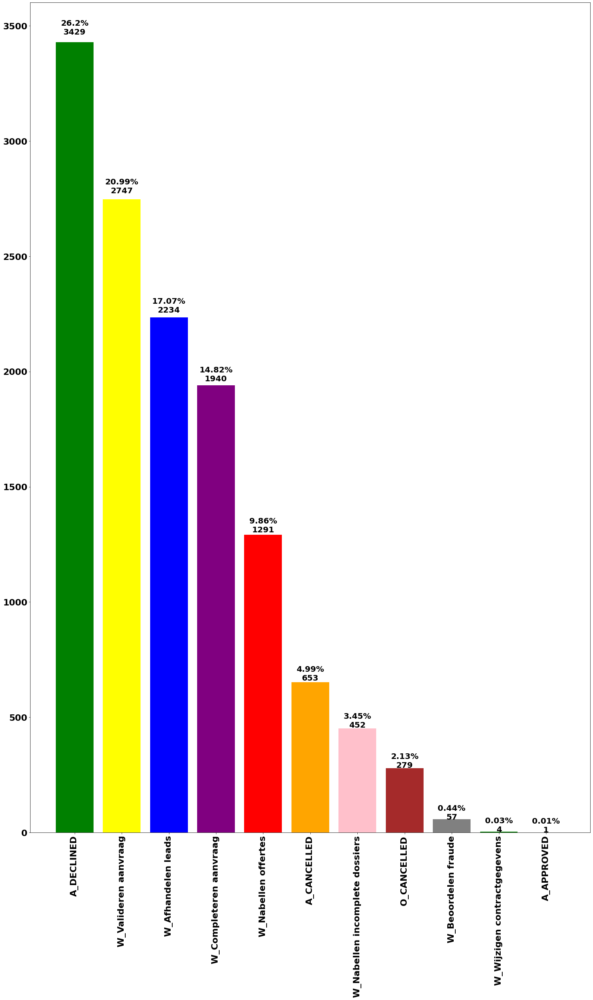

In [17]:
# compute percentage of each format
total_end_activities = end_activities_df.Count.sum()

percentage = []
for i in range(end_activities_df.shape[0]):
    pct = (end_activities_df.Count[i] / total_end_activities) * 100
    percentage.append(round(pct,2))
    
end_activities_df['Percentage'] = percentage
 
# depict illustration
plt.figure(figsize=(25,38))
plt.xticks(rotation='vertical',size = 22,weight = 'bold')
plt.yticks(size = 22 , weight = 'bold')
colors_list = ['Green','Yellow', 'Blue', 'Purple','Red' , 'Orange','Pink','Brown','Gray']
graph = plt.bar(end_activities_df.index,end_activities_df.Count, color = colors_list)

 
i = 0
for p in graph:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy()
    plt.text(x+width/2,
             y+height*1.01,
             str(end_activities_df.Percentage[i])+'%' + '\n' + str(end_activities_df.Count[i]),
             ha='center',
             weight='bold',
             size ='20'
             )
    i+=1
plt.savefig('end_activities_bar.svg')
plt.show()


In [18]:
activities = pm4py.get_event_attribute_values(log_df, "concept:name")


In [19]:
activities

{'A_ACCEPTED': 5113,
 'A_ACTIVATED': 2246,
 'A_APPROVED': 2246,
 'A_CANCELLED': 2807,
 'A_DECLINED': 7635,
 'A_FINALIZED': 5015,
 'A_PARTLYSUBMITTED': 13087,
 'A_PREACCEPTED': 7367,
 'A_REGISTERED': 2246,
 'A_SUBMITTED': 13087,
 'O_ACCEPTED': 2243,
 'O_CANCELLED': 3655,
 'O_CREATED': 7030,
 'O_DECLINED': 802,
 'O_SELECTED': 7030,
 'O_SENT': 7030,
 'O_SENT_BACK': 3454,
 'W_Afhandelen leads': 16566,
 'W_Beoordelen fraude': 664,
 'W_Completeren aanvraag': 54850,
 'W_Nabellen incomplete dossiers': 25190,
 'W_Nabellen offertes': 52016,
 'W_Valideren aanvraag': 20809,
 'W_Wijzigen contractgegevens': 12}

In [20]:
# Get the application states 
application_Dict = {}
for key, value in activities.items():   # iter on both keys and values
        if key.startswith('A_'):
                application_Dict[key] =  value

In [21]:
application_Dict

{'A_ACCEPTED': 5113,
 'A_ACTIVATED': 2246,
 'A_APPROVED': 2246,
 'A_CANCELLED': 2807,
 'A_DECLINED': 7635,
 'A_FINALIZED': 5015,
 'A_PARTLYSUBMITTED': 13087,
 'A_PREACCEPTED': 7367,
 'A_REGISTERED': 2246,
 'A_SUBMITTED': 13087}

In [22]:
application_Dict_df = pd.DataFrame.from_dict(application_Dict, orient = 'index' , columns = ["Count"])

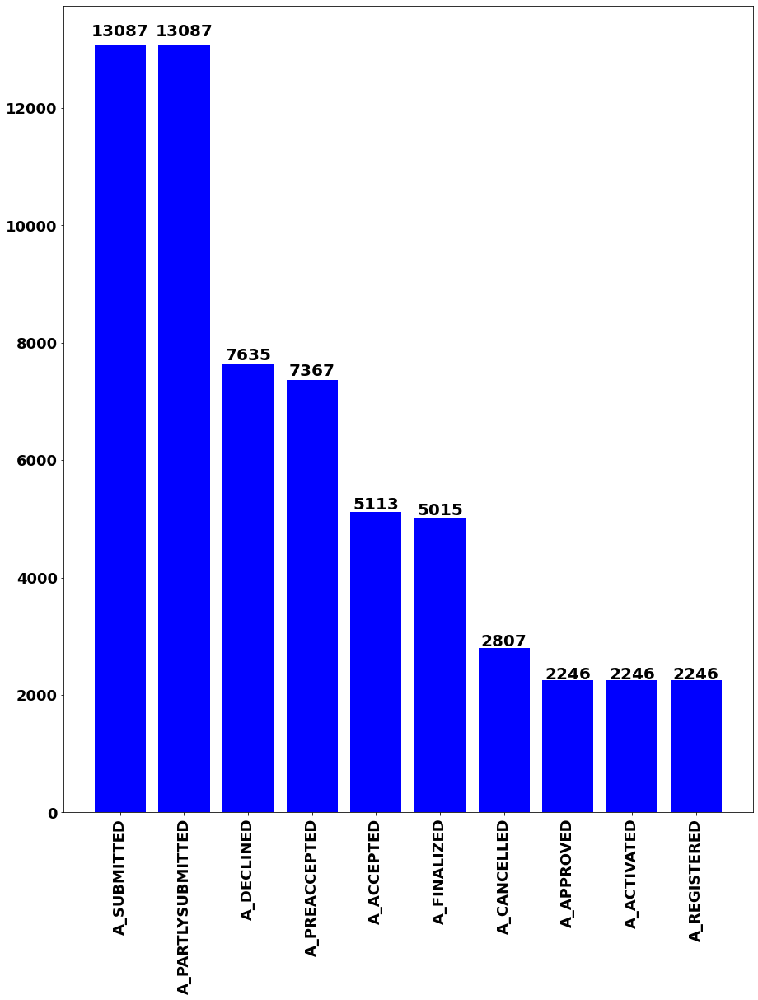

In [23]:
# depict illustration
plt.figure(figsize=(15,18))
plt.xticks(rotation='vertical',size = 18,weight = 'bold')
plt.yticks(size = 18 , weight = 'bold')
graph = plt.bar(application_Dict_df.index,application_Dict_df.Count, color = 'blue')

 
i = 0
for p in graph:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy()
    plt.text(x+width/2,
             y+height*1.01,
             str(application_Dict_df.Count[i]),
             ha='center',
             weight='bold',
             size ='20'
             )
    i+=1
plt.savefig('application_state_bar.png')
plt.show()

In [24]:
# Get the offer states 
offer_Dict = {}
for key, value in activities.items():   # iter on both keys and values
        if key.startswith('O_'):
                offer_Dict[key] =  value

In [25]:
# Merge offer states with application states and then sort them to find the standard-flow
offer_Dict.update(application_Dict)

sorted_values = sorted(offer_Dict.values(),reverse=True) # Sort the values
sorted_dict = {}

for i in sorted_values:
    for k in offer_Dict.keys():
        if offer_Dict[k] == i:
            sorted_dict[k] = offer_Dict[k]
            

print(sorted_dict)

{'A_SUBMITTED': 13087, 'A_PARTLYSUBMITTED': 13087, 'A_DECLINED': 7635, 'A_PREACCEPTED': 7367, 'O_SELECTED': 7030, 'O_CREATED': 7030, 'O_SENT': 7030, 'A_ACCEPTED': 5113, 'A_FINALIZED': 5015, 'O_CANCELLED': 3655, 'O_SENT_BACK': 3454, 'A_CANCELLED': 2807, 'A_APPROVED': 2246, 'A_ACTIVATED': 2246, 'A_REGISTERED': 2246, 'O_ACCEPTED': 2243, 'O_DECLINED': 802}


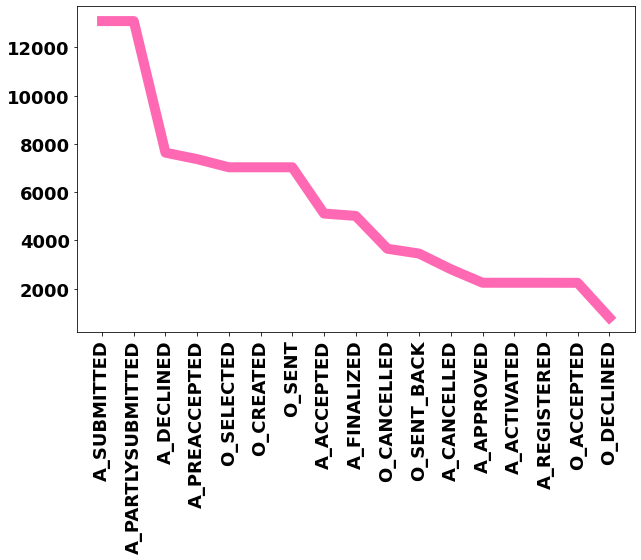

In [26]:
# Plot the illustration
t = tuple(sorted_dict.items())
x, y = zip(*t) # unpack a list of pairs into two tuples
plt.figure(figsize=(10,6))
plt.xticks(rotation='vertical',size = 18,weight = 'bold')
plt.yticks(size = 18 , weight = 'bold')
plt.plot(x, y,c = 'hotpink',linewidth = '10')
plt.savefig('standard-flow.svg')
plt.show()

In [27]:
O_states = ['O_ACCEPTED' , 'O_CANCELLED', 'O_CREATED','O_DECLINED' , 'O_SELECTED', 'O_SENT', 'O_SENT_BACK']
A_states = ['A_ACCEPTED','A_ACTIVATED','A_APPROVED','A_CANCELLED','A_DECLINED','A_FINALIZED','A_PARTLYSUBMITTED','A_PREACCEPTED','A_REGISTERED','A_SUBMITTED']
W_states = ['W_Afhandelen leads' , 'W_Beoordelen fraude','W_Completeren aanvraag','W_Nabellen incomplete dossiers','W_Nabellen offertes','W_Valideren aanvraag','W_Wijzigen contractgegevens']

In [28]:
application_df = log_df[log_df['concept:name'].isin(A_states)] 
offer_df = log_df[log_df['concept:name'].isin(O_states)]
workItem_df = log_df[log_df['concept:name'].isin(W_states)]

In [29]:
application_df

,org:resource,lifecycle:transition,concept:name,time:timestamp,case:REG_DATE,case:concept:name,case:AMOUNT_REQ
0,112,COMPLETE,A_SUBMITTED,2011-09-30 22:38:44.546000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000
1,112,COMPLETE,A_PARTLYSUBMITTED,2011-09-30 22:38:44.880000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000
2,112,COMPLETE,A_PREACCEPTED,2011-09-30 22:39:37.906000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000
26,112,COMPLETE,A_SUBMITTED,2011-10-01 06:08:58.256000+00:00,2011-10-01 06:08:58.256000+00:00,173691,5000
27,112,COMPLETE,A_PARTLYSUBMITTED,2011-10-01 06:09:02.195000+00:00,2011-10-01 06:08:58.256000+00:00,173691,5000
...,...,...,...,...,...,...,...
231114,11339,COMPLETE,A_APPROVED,2012-03-14 14:31:28.859000+00:00,2012-02-13 14:50:41.425000+00:00,208901,11000
231117,11339,COMPLETE,A_REGISTERED,2012-03-14 14:31:28.859000+00:00,2012-02-13 14:50:41.425000+00:00,208901,11000
216869,10809,COMPLETE,A_APPROVED,2012-03-14 14:33:57.651000+00:00,2012-02-05 15:42:18.178000+00:00,206615,22000
216870,10809,COMPLETE,A_REGISTERED,2012-03-14 14:33:57.651000+00:00,2012-02-05 15:42:18.178000+00:00,206615,22000


In [30]:
offer_df

,org:resource,lifecycle:transition,concept:name,time:timestamp,case:REG_DATE,case:concept:name,case:AMOUNT_REQ
210,10862,COMPLETE,O_SELECTED,2011-10-01 08:44:40.725000+00:00,2011-10-01 08:37:39.362000+00:00,173718,15000
211,10862,COMPLETE,O_CREATED,2011-10-01 08:44:42.707000+00:00,2011-10-01 08:37:39.362000+00:00,173718,15000
212,10862,COMPLETE,O_SENT,2011-10-01 08:44:42.734000+00:00,2011-10-01 08:37:39.362000+00:00,173718,15000
218,10862,COMPLETE,O_SELECTED,2011-10-01 08:46:52.915000+00:00,2011-10-01 08:37:39.362000+00:00,173718,15000
219,10862,COMPLETE,O_CANCELLED,2011-10-01 08:46:52.915000+00:00,2011-10-01 08:37:39.362000+00:00,173718,15000
...,...,...,...,...,...,...,...
229717,11169,COMPLETE,O_SENT,2012-03-14 14:46:23.386000+00:00,2012-02-12 20:44:14.534000+00:00,208652,20000
260268,11169,COMPLETE,O_SELECTED,2012-03-14 14:50:58.333000+00:00,2012-02-29 08:35:19.601000+00:00,213998,12500
260269,11169,COMPLETE,O_CANCELLED,2012-03-14 14:50:58.333000+00:00,2012-02-29 08:35:19.601000+00:00,213998,12500
260270,11169,COMPLETE,O_CREATED,2012-03-14 14:50:59.651000+00:00,2012-02-29 08:35:19.601000+00:00,213998,12500


In [31]:
workItem_df

,org:resource,lifecycle:transition,concept:name,time:timestamp,case:REG_DATE,case:concept:name,case:AMOUNT_REQ
3,112,SCHEDULE,W_Completeren aanvraag,2011-09-30 22:39:38.875000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000
29,112,SCHEDULE,W_Completeren aanvraag,2011-10-01 06:09:59.578000+00:00,2011-10-01 06:08:58.256000+00:00,173691,5000
68,112,SCHEDULE,W_Completeren aanvraag,2011-10-01 06:11:13.390000+00:00,2011-10-01 06:10:30.287000+00:00,173694,7000
141,112,SCHEDULE,W_Afhandelen leads,2011-10-01 07:46:18.623000+00:00,2011-10-01 07:45:37.274000+00:00,173706,18000
133,112,SCHEDULE,W_Completeren aanvraag,2011-10-01 07:46:18.674000+00:00,2011-10-01 07:45:25.806000+00:00,173703,13500
...,...,...,...,...,...,...,...
256158,10863,START,W_Nabellen incomplete dossiers,2012-03-14 14:59:28.309000+00:00,2012-02-27 13:12:41.868000+00:00,213276,15000
256159,10863,COMPLETE,W_Nabellen incomplete dossiers,2012-03-14 15:00:09.680000+00:00,2012-02-27 13:12:41.868000+00:00,213276,15000
235011,11169,START,W_Nabellen offertes,2012-03-14 15:02:03.883000+00:00,2012-02-15 09:10:36.503000+00:00,209595,13000
246922,11203,START,W_Nabellen incomplete dossiers,2012-03-14 15:04:46.192000+00:00,2012-02-21 22:38:40.044000+00:00,211624,35000


In [32]:
log_df

,org:resource,lifecycle:transition,concept:name,time:timestamp,case:REG_DATE,case:concept:name,case:AMOUNT_REQ
0,112,COMPLETE,A_SUBMITTED,2011-09-30 22:38:44.546000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000
1,112,COMPLETE,A_PARTLYSUBMITTED,2011-09-30 22:38:44.880000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000
2,112,COMPLETE,A_PREACCEPTED,2011-09-30 22:39:37.906000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000
3,112,SCHEDULE,W_Completeren aanvraag,2011-09-30 22:39:38.875000+00:00,2011-09-30 22:38:44.546000+00:00,173688,20000
26,112,COMPLETE,A_SUBMITTED,2011-10-01 06:08:58.256000+00:00,2011-10-01 06:08:58.256000+00:00,173691,5000
...,...,...,...,...,...,...,...
256158,10863,START,W_Nabellen incomplete dossiers,2012-03-14 14:59:28.309000+00:00,2012-02-27 13:12:41.868000+00:00,213276,15000
256159,10863,COMPLETE,W_Nabellen incomplete dossiers,2012-03-14 15:00:09.680000+00:00,2012-02-27 13:12:41.868000+00:00,213276,15000
235011,11169,START,W_Nabellen offertes,2012-03-14 15:02:03.883000+00:00,2012-02-15 09:10:36.503000+00:00,209595,13000
246922,11203,START,W_Nabellen incomplete dossiers,2012-03-14 15:04:46.192000+00:00,2012-02-21 22:38:40.044000+00:00,211624,35000


In [33]:
# Profiling offer sub process
log_profile = log_df.groupby('case:concept:name').agg(
Activity = ('concept:name', 'count'),\
Activity_list = ('concept:name', lambda x: ','.join(x) ),\
Resource = ('org:resource', 'nunique'),\
Duration = ('time:timestamp', lambda x: x.max()- x.min()),\
)

In [34]:

# Mean Duration with out 0 day
log_mean_df = log_profile['Duration'].agg('mean')
print('mean = ', log_mean_df)

# Mean Duration with 0 day
mean_log_df_filtered = log_profile[(log_profile['Duration'] > np.timedelta64(24, 'h'))].agg('mean')
print('mean with 0 day filtered = ', mean_log_df_filtered)

mean =  8 days 14:58:20.095970734
mean with 0 day filtered =  Activity                      35.67471
Resource                      7.178124
Duration    17 days 18:56:12.906549928
dtype: object


/usr/local/lib/python3.7/dist-packages/pandas/core/apply.py:577: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  return f(*args, **kwargs)


In [35]:
# Extract the variants from the event log
variants = variants_filter.get_variants(log)
variants

{'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_Completeren aanvraag,W_Completeren aanvraag,A_ACCEPTED,O_SELECTED,A_FINALIZED,O_CREATED,O_SENT,W_Nabellen offertes,W_Completeren aanvraag,W_Nabellen offertes,W_Nabellen offertes,W_Nabellen offertes,W_Nabellen offertes,W_Nabellen offertes,O_SENT_BACK,W_Valideren aanvraag,W_Nabellen offertes,W_Valideren aanvraag,A_REGISTERED,A_APPROVED,O_ACCEPTED,A_ACTIVATED,W_Valideren aanvraag': [{'attributes': {'REG_DATE': datetime.datetime(2011, 10, 1, 0, 38, 44, 546000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200))), 'concept:name': '173688', 'AMOUNT_REQ': '20000'}, 'events': [{'org:resource': '112', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'A_SUBMITTED', 'time:timestamp': datetime.datetime(2011, 10, 1, 0, 38, 44, 546000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200))), 'case:REG_DATE': datetime.datetime(2011, 10, 1, 0, 38, 44, 546000, tzinfo=datetime.timezone(datetime.timedelta(seconds=7200))), 'case:concept:name': 

In [36]:
len(variants)

4366

In [37]:
from pm4py.statistics.traces.generic.log import case_statistics
variants_count = case_statistics.get_variant_statistics(log)

variants_count

[{'count': 3429, 'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_DECLINED'},
 {'count': 1872,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen leads,W_Afhandelen leads,A_DECLINED,W_Afhandelen leads'},
 {'count': 271,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen leads,W_Afhandelen leads,W_Afhandelen leads,W_Afhandelen leads,A_DECLINED,W_Afhandelen leads'},
 {'count': 209,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen leads,W_Afhandelen leads,A_PREACCEPTED,W_Completeren aanvraag,W_Afhandelen leads,W_Completeren aanvraag,A_DECLINED,W_Completeren aanvraag'},
 {'count': 160,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_Completeren aanvraag,W_Completeren aanvraag,A_DECLINED,W_Completeren aanvraag'},
 {'count': 134,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_Completeren aanvraag,W_Completeren aanvraag,A_CANCELLED,W_Completeren aanvraag'},
 {'count': 126,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen leads,W_Afhandelen leads

In [38]:
# Number of variants
len(variants_count)


4366

In [39]:
# Sort the counted variants
variants_count = sorted(variants_count, key=lambda x:x['count'], reverse = True)
variants_count

[{'count': 3429, 'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_DECLINED'},
 {'count': 1872,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen leads,W_Afhandelen leads,A_DECLINED,W_Afhandelen leads'},
 {'count': 271,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen leads,W_Afhandelen leads,W_Afhandelen leads,W_Afhandelen leads,A_DECLINED,W_Afhandelen leads'},
 {'count': 209,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen leads,W_Afhandelen leads,A_PREACCEPTED,W_Completeren aanvraag,W_Afhandelen leads,W_Completeren aanvraag,A_DECLINED,W_Completeren aanvraag'},
 {'count': 160,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_Completeren aanvraag,W_Completeren aanvraag,A_DECLINED,W_Completeren aanvraag'},
 {'count': 134,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_Completeren aanvraag,W_Completeren aanvraag,A_CANCELLED,W_Completeren aanvraag'},
 {'count': 126,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen leads,W_Afhandelen leads

In [40]:
# Convert from event data to dataframe in pandas
variants_df = pd.DataFrame.from_records(variants_count)
variants_df

,variant,count
0,"A_SUBMITTED,A_PARTLYSUBMITTED,A_DECLINED",3429
1,"A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen lea...",1872
2,"A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen lea...",271
3,"A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen lea...",209
4,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_...",160
...,...,...
4361,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_...",1
4362,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_...",1
4363,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_...",1
4364,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_...",1


In [41]:
variants_df.head(5)

,variant,count
0,"A_SUBMITTED,A_PARTLYSUBMITTED,A_DECLINED",3429
1,"A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen lea...",1872
2,"A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen lea...",271
3,"A_SUBMITTED,A_PARTLYSUBMITTED,W_Afhandelen lea...",209
4,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,W_...",160


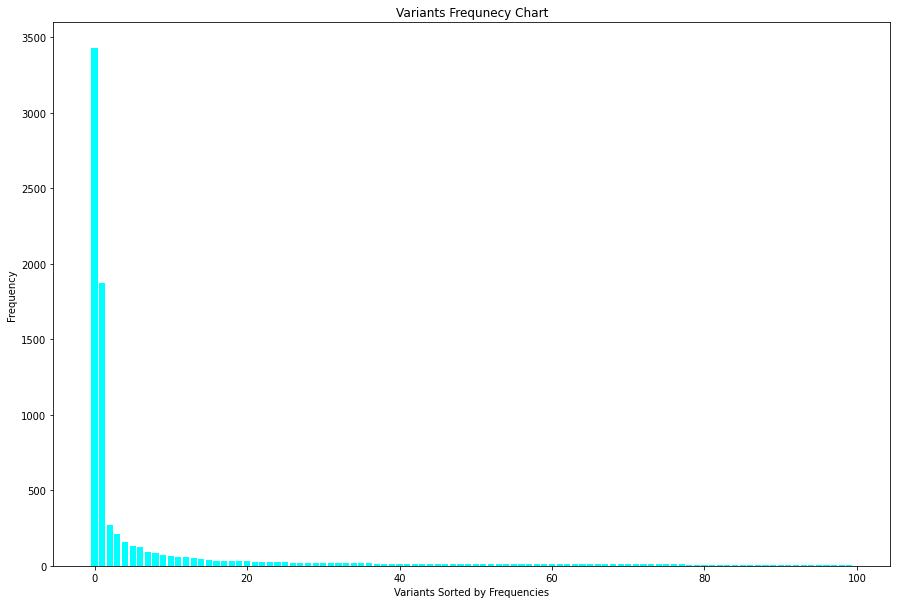

In [42]:
# Prepare the dimensions to plot
# Put variants and counts into lists of prefered length
variant = variants_df[0:100].index
frequency = variants_df[0:100]['count']


# Return a list of log values from a list
frequency_log = [math.log(i, 2) for i in frequency]

# Plot a histogram of the frequencies
fig = plt.figure(figsize = (15,10))


# Creating the step plot
plt.bar(variant, frequency, color= 'aqua')
plt.xlabel("Variants Sorted by Frequencies")
plt.ylabel("Frequency")
plt.title("Variants Frequnecy Chart")
plt.savefig('Variants_Frequency_log.png')
plt.show()

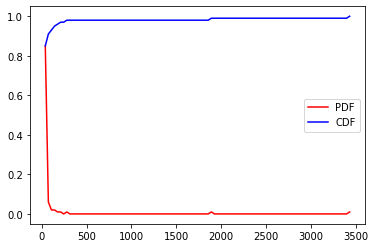

In [43]:
%matplotlib inline

data = variants_df[0:100]['count']

# Getting data of the histogram
count, bins_count = np.histogram(data, bins=100)

# Finding the PDF of the histogram using count values
pdf = count / sum(count)
#print(pdf)

# Using numpy np.cumsum to calculate the CDF
# We can also find using the PDF values by looping and adding

cdf = np.cumsum(pdf)
#print(cdf)


# Plotting PDF and CDF
plt.plot(bins_count[1:], pdf, color='red',label='PDF')
plt.plot(bins_count[1:], cdf, color='blue', label='CDF')
plt.legend()

In [44]:
more_3_times_filling_information_count = 0
need_additional_information = 0
modifying_approved_contracts = 0
suspecting_fraud_cases = 0
more_than_one_incomplete_initial_submission =0
never_approved = 0
one_time_approved = 0

for variant in variants_count:
    if "A_PREACCEPTED" in variant['variant']:
      one_time_approved += variant['count']
    if "A_PREACCEPTED" not in variant['variant']:
      never_approved += variant['count']

    if variant['variant'].count('W_Completeren aanvraag') > 3:
      more_3_times_filling_information_count += variant['count']
      

    if 'W_Beoordelen fraude' in variant['variant']:
      suspecting_fraud_cases += variant['count']

    if  'W_Nabellen incomplete dossiers' in variant['variant']:
      need_additional_information+=variant['count']

    if 'W_Wijzigen contractgegevens' in variant['variant']:
      modifying_approved_contracts+= variant['count']

print("one time approved = ", one_time_approved)
print("never approved = ", never_approved)
print("more than 3times filling information count = ", more_3_times_filling_information_count)
print("Susspecting fraud cases = ", suspecting_fraud_cases)
print("Seeking additional information :",need_additional_information)
print("modifying approved contracts :",modifying_approved_contracts)


one time approved =  7367
never approved =  5720
more than 3times filling information count =  4420
Susspecting fraud cases =  108
Seeking additional information : 1647
modifying approved contracts : 7


# Application Sub Process (ASP) Analyzes

In [137]:
application_log = pm4py.convert_to_event_log(application_df)

In [138]:
# Profiling offer sub process
application_profile = application_df.groupby('case:concept:name').agg(
Activity = ('concept:name', 'count'),\
Activity_list = ('concept:name', lambda x: ','.join(x) ),\
Resource = ('org:resource', 'nunique'),\
Duration = ('time:timestamp', lambda x: x.max()- x.min()),\
)

In [139]:
# Analysis on offer sub process

# Number of cases
print("Number of cases : ",len(application_log))

# Number of events
print("Number of events :",len(application_df))

# First Timestamp
first = application_df['time:timestamp'].min()
print(first)

# Last Timestamp
last = application_df['time:timestamp'].max()
print(last)

# Mean Duration with out 0 day
mean_application_df = application_profile['Duration'].agg('mean')
print('mean = ', mean_application_df)

# Mean Duration with 0 day
mean_application_df_filtered = application_profile[(application_profile['Duration'] > np.timedelta64(25, 'h'))].agg('mean')
print('mean with 0 day filtered = ', mean_application_df_filtered)

# Number of types
application_types = application_df['concept:name'].nunique()
print("Number of types :",application_types)

# Number of resource
number_resources = application_df['org:resource'].nunique()
print("Number of resources = ",number_resources)

Number of cases :  13087
Number of events : 60849
2011-09-30 22:38:44.546000+00:00
2012-03-14 14:33:57.651000+00:00
mean =  8 days 01:55:14.860649805
mean with 0 day filtered =  Activity                       6.29851
Resource                      2.847983
Duration    17 days 13:08:00.343700820
dtype: object
Number of types : 10
Number of resources =  61


/usr/local/lib/python3.7/dist-packages/pandas/core/apply.py:577: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  return f(*args, **kwargs)


In [140]:
#Variant Analysis on ASP
# Extract the variants from the event log
variants = variants_filter.get_variants(application_log)
variants

{'A_SUBMITTED,A_PARTLYSUBMITTED,A_CANCELLED': [{'attributes': {'REG_DATE': Timestamp('2011-12-13 20:29:24.105000+0000', tz='UTC'), 'concept:name': '193378', 'AMOUNT_REQ': '0'}, 'events': [{'org:resource': '112', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'A_SUBMITTED', 'time:timestamp': Timestamp('2011-12-13 20:29:24.106000+0000', tz='UTC')}, '..', {'org:resource': '10779', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'A_CANCELLED', 'time:timestamp': Timestamp('2011-12-14 08:43:25.393000+0000', tz='UTC')}]}],
 'A_SUBMITTED,A_PARTLYSUBMITTED,A_DECLINED': [{'attributes': {'REG_DATE': Timestamp('2011-10-01 06:11:08.865000+0000', tz='UTC'), 'concept:name': '173697', 'AMOUNT_REQ': '15000'}, 'events': [{'org:resource': '112', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'A_SUBMITTED', 'time:timestamp': Timestamp('2011-10-01 06:11:08.866000+0000', tz='UTC')}, '..', {'org:resource': '112', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'A_DECLINED', 'time:timestamp'

In [141]:
len(variants)

17

In [142]:
variants_count = case_statistics.get_variant_statistics(application_log)
variants_count

[{'count': 5719, 'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_DECLINED'},
 {'count': 1640,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_ACCEPTED,A_FINALIZED,A_CANCELLED'},
 {'count': 1100,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_CANCELLED'},
 {'count': 1085,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_DECLINED'},
 {'count': 802,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_ACCEPTED,A_FINALIZED,A_DECLINED'},
 {'count': 617,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_ACCEPTED,A_FINALIZED,A_APPROVED,A_REGISTERED,A_ACTIVATED'},
 {'count': 504,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_ACCEPTED,A_FINALIZED,A_APPROVED,A_ACTIVATED,A_REGISTERED'},
 {'count': 378,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_ACCEPTED,A_FINALIZED,A_REGISTERED,A_APPROVED,A_ACTIVATED'},
 {'count': 327,
  'variant': 'A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_ACCEPTED,A_FINALIZED'},
 {'count': 283,


In [143]:
len(variants_count)

17

In [144]:
# Convert from event data to dataframe in pandas
variants_df = pd.DataFrame.from_records(variants_count)
variants_df

,variant,count
0,"A_SUBMITTED,A_PARTLYSUBMITTED,A_DECLINED",5719
1,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",1640
2,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",1100
3,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",1085
4,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",802
5,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",617
6,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",504
7,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",378
8,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",327
9,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",283


In [145]:
# Top 5 variants
variants_df.head(5)

,variant,count
0,"A_SUBMITTED,A_PARTLYSUBMITTED,A_DECLINED",5719
1,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",1640
2,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",1100
3,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",1085
4,"A_SUBMITTED,A_PARTLYSUBMITTED,A_PREACCEPTED,A_...",802


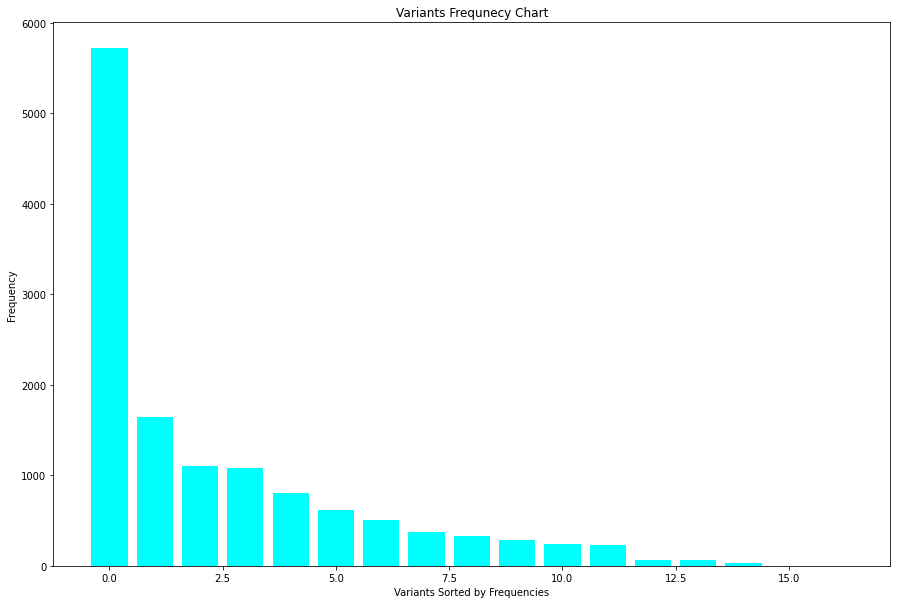

In [146]:
# Prepare the dimensions to plot
# Put variants and counts into lists of prefered length
variant = variants_df[0:100].index
frequency = variants_df[0:100]['count']


# Return a list of log values from a list
frequency_log = [math.log(i, 2) for i in frequency]

# Plot a histogram of the frequencies
fig = plt.figure(figsize = (15,10))


# Creating the step plot
plt.bar(variant, frequency, color= 'aqua')
plt.xlabel("Variants Sorted by Frequencies")
plt.ylabel("Frequency")
plt.title("Variants Frequnecy Chart")
plt.savefig('Variants_Frequency_ASP.png')
plt.show()

In [147]:
activities = pm4py.get_event_attribute_values(application_df, "concept:name")

In [148]:
activities

{'A_ACCEPTED': 5113,
 'A_ACTIVATED': 2246,
 'A_APPROVED': 2246,
 'A_CANCELLED': 2807,
 'A_DECLINED': 7635,
 'A_FINALIZED': 5015,
 'A_PARTLYSUBMITTED': 13087,
 'A_PREACCEPTED': 7367,
 'A_REGISTERED': 2246,
 'A_SUBMITTED': 13087}

In [149]:
never_accepted = 0
finalized = 0
accepted = 0
pre_accepted_and_rejection = 0

for variant in variants_count:
    if "A_ACCEPTED" not in variant['variant']:
      never_accepted += variant['count']
    if 'A_FINALIZED' in variant['variant']:
      finalized += variant['count']


    if "A_PREACCEPTED" in variant['variant']:
      if "A_CANCELLED" in variant['variant']:
        pre_accepted_and_rejection +=variant['count']
    if "A_ACTIVATED" in variant['variant'] or "A_REGISTERED" in variant['variant'] or "A_APPROVED" in variant['variant']:
        accepted+=variant['count']
   
print("Never Accepted : ", one_time_approved)
print("Finalized = ", finalized)
print("Accepted", accepted)
print("Pre Accepted and Reject = ", pre_accepted_and_rejection)

Never Accepted :  7367
Finalized =  5015
Accepted 2246
Pre Accepted and Reject =  2806


In [150]:
# Filter by start activities
start_activites = pm4py.get_start_activities(application_df)
start_activities_df = pd.DataFrame.from_dict(start_activites,orient='index',columns = ["Count"])
start_activities_df

,Count
A_SUBMITTED,13087


In [151]:
# Filter by end activities
end_activities = pm4py.get_end_activities(application_df)
end_activities_df = pd.DataFrame.from_dict(end_activities,orient='index',columns = ["Count"])
end_activities_df

,Count
A_DECLINED,7635
A_CANCELLED,2807
A_ACTIVATED,995
A_REGISTERED,787
A_APPROVED,464
A_FINALIZED,327
A_PREACCEPTED,69
A_ACCEPTED,3


In [178]:
# Filter on preaccepted cases
application_log_filtered = pm4py.filter_event_attribute_values(application_log, "concept:name", ["A_PREACCEPTED"], level="case", retain=True)

In [341]:
len(application_log)

13087

In [342]:
len(application_log_filtered)

7367

In [168]:
# Process Discovery

In [169]:
# Alpha Miner

In [216]:
net, initial_marking, final_marking = alpha_miner.apply(application_log_filtered)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  


replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

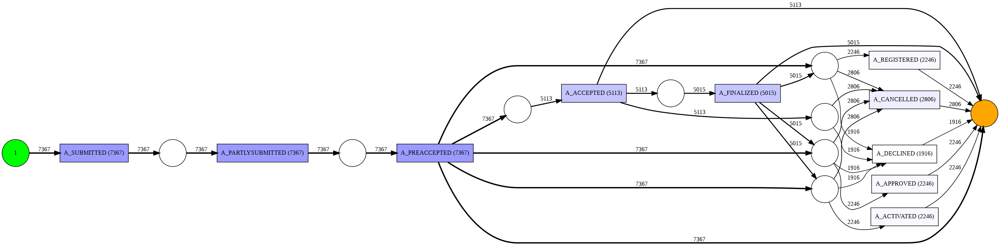

In [217]:
# Visualise 
gviz = pn_visualizer.apply(net, initial_marking, final_marking, variant=pn_visualizer.Variants.FREQUENCY, log=application_log_filtered)
pn_visualizer.view(gviz)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  


replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

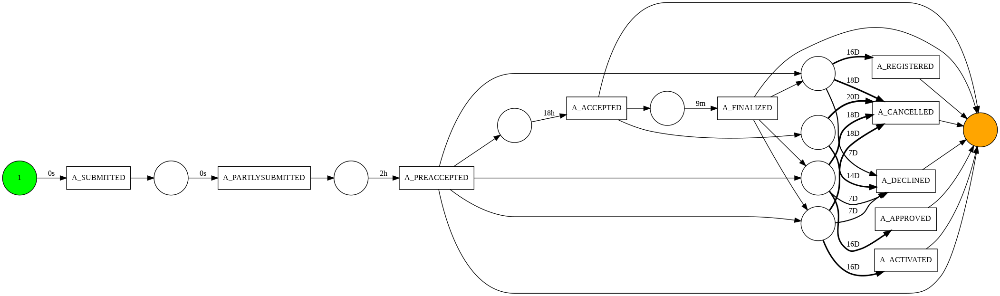

In [218]:
# Visualise 
gviz = pn_visualizer.apply(net, initial_marking, final_marking, variant=pn_visualizer.Variants.PERFORMANCE, log=application_log_filtered)
pn_visualizer.view(gviz)

In [219]:
# Conformance Checking for Alpha Miner

In [220]:
# Fitness

application_alpha_fitness = replay_fitness_evaluator.apply(application_log_filtered, net, initial_marking, final_marking, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)
# Precision

application_alpha_precision = precision_evaluator.apply(application_log_filtered, net, initial_marking, final_marking, variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
# Generalization

application_alpha_generalization = generalization_evaluator.apply(application_log_filtered, net, initial_marking, final_marking)
# Simplicity

application_alpha_simplicity = simplicity_evaluator.apply(net)

print("AM-Fitness-ASP :",application_alpha_fitness)
print("AM-Precision-ASP :",application_alpha_precision)
print("AM-Generalization-ASP :",application_alpha_generalization)
print("AM-Simplicity-ASP :",application_alpha_simplicity)


replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/14 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

AM-Fitness-ASP : {'perc_fit_traces': 0.0, 'average_trace_fitness': 0.792757097923675, 'log_fitness': 0.78117002367433, 'percentage_of_fitting_traces': 0.0}
AM-Precision-ASP : 0.5858837884132558
AM-Generalization-ASP : 0.9831916291176208
AM-Simplicity-ASP : 0.4


In [184]:
# Inductive Miner

In [223]:
# Inductive Miner Using Tree

In [224]:
tree = inductive_miner.apply_tree(application_log_filtered)

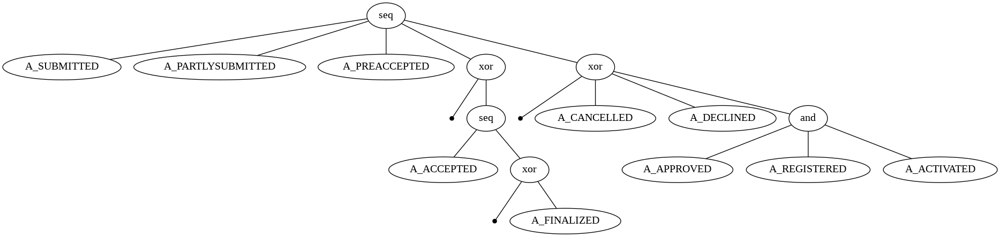

In [225]:
gviz = pt_visualizer.apply(tree, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})
pt_visualizer.view(gviz)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  import sys


replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

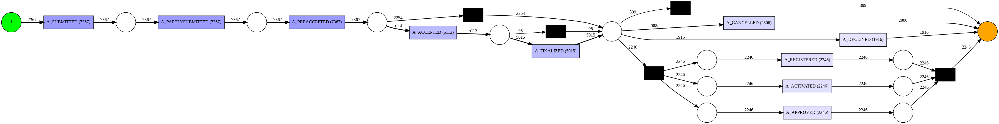

In [226]:
# Tree to Petri-net

net, initial_marking, final_marking = pt_converter.apply(tree)
## Then visualise
gviz = pn_visualizer.apply(net, initial_marking, final_marking, 
                           variant=pn_visualizer.Variants.FREQUENCY, 
                           log=application_log_filtered,parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})
pn_visualizer.view(gviz)

In [230]:
# Conformance Cheking
# Token-based replay matches a trace and a Petri net model,
# Alignment-based replay aims to find one of the best alignment between the trace and the model.

from pm4py.algo.conformance.tokenreplay import algorithm as token_replay
from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments

# Token-based replay matches a trace and a Petri net model,

replayed_traces = token_replay.apply(application_log, net, initial_marking, final_marking)


print("REPLAY")
print("Number of traces", len(replayed_traces))
#print(replayed_traces)

#print("Case", event_log[0].attributes['concept:name'])

anomalous_traces = []
i = 0
while i < len(replayed_traces):
	if replayed_traces[i]["trace_fitness"] < 1:
		anomalous_traces.append(application_log[i].attributes["concept:name"])
	i += 1
# print the list as a string
print(', '.join(map(str, anomalous_traces)))
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(replayed_traces))*100 , '%')

# Alignment-based replay aims to find one of the best alignment between the trace and the model.

aligned_traces = alignments.apply_log(application_log, net, initial_marking, final_marking)

print("ALIGNMENTS")
print("Number of traces", len(aligned_traces))

#print(aligned_traces)

anomalous_traces = []
i = 0
while i < len(aligned_traces):
	if aligned_traces[i]["fitness"] != 1:
		anomalous_traces.append(application_log[i].attributes["concept:name"])
		#anomalous_traces.append(aligned_traces[i]['alignment'])
	i += 1
# print the list as a string
#print(', '.join(map(str, anomalous_traces)))
print(anomalous_traces)
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(aligned_traces))*100 , '%')

replaying log with TBR, completed variants ::   0%|          | 0/17 [00:00<?, ?it/s]

REPLAY
Number of traces 13087
173697, 173700, 173727, 173733, 173757, 173763, 173769, 173772, 173778, 173802, 173808, 173820, 173832, 173838, 173850, 173853, 173856, 173862, 173865, 173874, 173877, 173883, 173886, 173889, 173892, 173895, 173901, 173904, 173907, 173910, 173916, 173922, 173931, 173934, 173952, 173961, 173991, 173994, 174003, 174006, 174015, 174021, 174027, 174033, 174051, 174054, 174057, 174063, 174066, 174072, 174075, 174081, 174108, 174114, 174117, 174123, 174126, 174129, 174135, 174156, 174162, 174165, 174171, 174174, 174183, 174189, 174192, 174204, 174210, 174222, 174225, 174228, 174234, 174246, 174267, 174273, 174276, 174282, 174300, 174328, 174340, 174346, 174352, 174355, 174364, 174370, 174373, 174376, 174391, 174412, 174427, 174439, 174442, 174454, 174460, 174466, 174472, 174499, 174514, 174520, 174523, 174526, 174532, 174544, 174574, 174599, 174617, 174623, 174626, 174632, 174641, 174647, 174662, 174665, 174668, 174674, 174677, 174680, 174692, 174698, 174701, 17

aligning log, completed variants ::   0%|          | 0/17 [00:00<?, ?it/s]

ALIGNMENTS
Number of traces 13087
['173697', '173700', '173727', '173733', '173757', '173763', '173769', '173772', '173778', '173802', '173808', '173820', '173832', '173838', '173850', '173853', '173856', '173862', '173865', '173874', '173877', '173883', '173886', '173889', '173892', '173895', '173901', '173904', '173907', '173910', '173916', '173922', '173931', '173934', '173952', '173961', '173991', '173994', '174003', '174006', '174015', '174021', '174027', '174033', '174051', '174054', '174057', '174063', '174066', '174072', '174075', '174081', '174108', '174114', '174117', '174123', '174126', '174129', '174135', '174156', '174162', '174165', '174171', '174174', '174183', '174189', '174192', '174204', '174210', '174222', '174225', '174228', '174234', '174246', '174267', '174273', '174276', '174282', '174300', '174328', '174340', '174346', '174352', '174355', '174364', '174370', '174373', '174376', '174391', '174412', '174427', '174439', '174442', '174454', '174460', '174466', '1744

In [232]:
# Conformance Checking for Inductive Miner

In [194]:
# Fitness
application_inductive_fitness = replay_fitness_evaluator.apply(application_log_filtered, net, initial_marking, final_marking, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)
# Precision
application_inductive_precision = precision_evaluator.apply(application_log_filtered, net, initial_marking, final_marking, variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
# Generalization
application_inductive_generalization = generalization_evaluator.apply(application_log_filtered, net, initial_marking, final_marking)
# Simplicity
application_inductive_simplicity = simplicity_evaluator.apply(net)


print("Fitness of inductive for application sub process :",application_inductive_fitness)
print("Precision of inductive for application sub process :",application_inductive_precision)
print("Generalization of inductive for application sub process :",application_inductive_generalization)
print("Simplicity of inductive for application sub process :",application_inductive_simplicity)

replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/14 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

Fitness of inductive for application sub process : {'perc_fit_traces': 100.0, 'average_trace_fitness': 1.0, 'log_fitness': 1.0, 'percentage_of_fitting_traces': 100.0}
Precision of inductive for application sub process : 0.7062662258240153
Generalization of inductive for application sub process : 0.974504936777826
Simplicity of inductive for application sub process : 0.7000000000000001


In [199]:
# Heuristic Miner

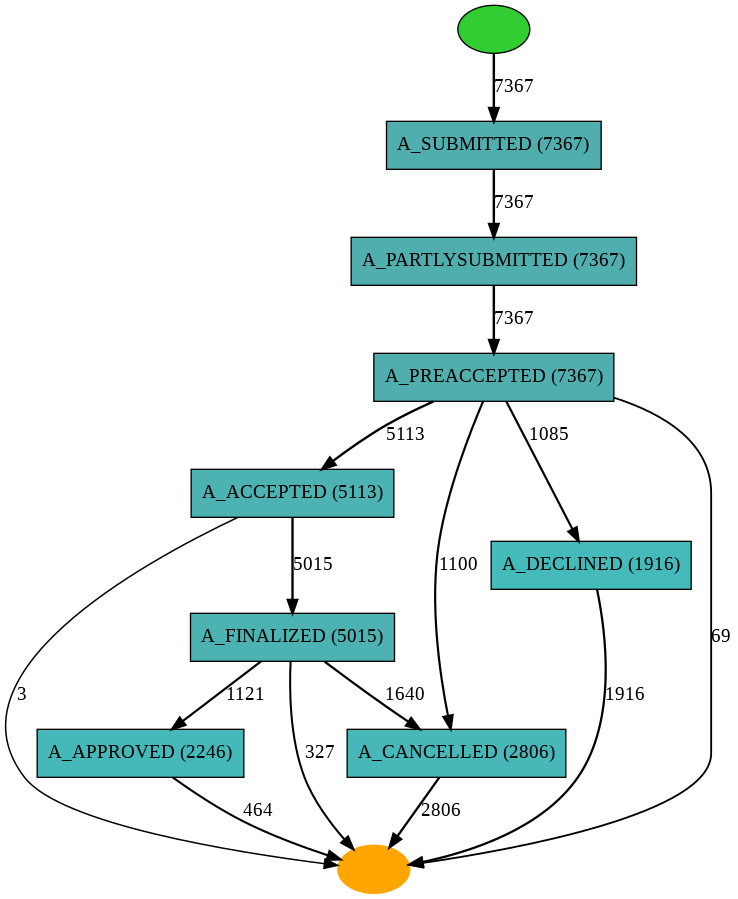

In [234]:

net = heuristics_miner.apply_heu(application_log_filtered, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.999})

gviz = hn_visualizer.apply(net)
hn_visualizer.view(gviz)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  after removing the cwd from sys.path.


replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

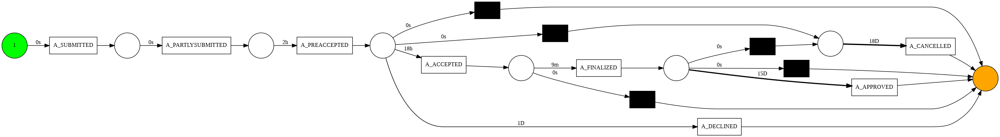

In [235]:
# Visualize Heuristic as Petri-net (FREQUENCY)
net, initial_marking, final_marking = heuristics_miner.apply(application_log_filtered, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.999})

gviz = pn_visualizer.apply(net, initial_marking, final_marking, variant=pn_visualizer.Variants.PERFORMANCE, log=application_log_filtered)
pn_visualizer.view(gviz)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  after removing the cwd from sys.path.


replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

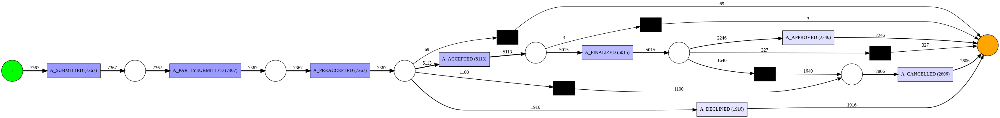

In [236]:
# Visualize Heuristic as Petri-net (PERFORMANCE)
net, initial_marking, final_marking = heuristics_miner.apply(application_log_filtered, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.999})

gviz = pn_visualizer.apply(net, initial_marking, final_marking, variant=pn_visualizer.Variants.FREQUENCY, log=application_log_filtered)
pn_visualizer.view(gviz)

In [274]:
# Conformance Checking for Heuristic Miner


In [237]:
# Fitness
application_heuristic_fitness = replay_fitness_evaluator.apply(application_log_filtered, net, initial_marking, final_marking, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)
# Precision
application_heuristic_precision = precision_evaluator.apply(application_log_filtered, net, initial_marking, final_marking, variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
# Generalization
application_heuristic_generalization = generalization_evaluator.apply(application_log_filtered, net, initial_marking, final_marking)
# Simplicity
application_heuristic_simplicity = simplicity_evaluator.apply(net)

print("Fitness of heuristic for offer sub process :",application_heuristic_fitness)
print("Precision of heuristic for offer sub process :",application_heuristic_precision)
print("Generalization of heuristic for offer sub process :",application_heuristic_generalization)
print("Simplicity of heuristic for offer sub process :",application_heuristic_simplicity)

replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/14 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/15 [00:00<?, ?it/s]

Fitness of heuristic for offer sub process : {'perc_fit_traces': 87.82408035835482, 'average_trace_fitness': 0.982298797080939, 'log_fitness': 0.981952799629801, 'percentage_of_fitting_traces': 87.82408035835482}
Precision of heuristic for offer sub process : 0.9742292284986782
Generalization of heuristic for offer sub process : 0.9281720691687483
Simplicity of heuristic for offer sub process : 0.6774193548387096


In [238]:
# Conformance Cheking
# Token-based replay matches a trace and a Petri net model,
# Alignment-based replay aims to find one of the best alignment between the trace and the model.

from pm4py.algo.conformance.tokenreplay import algorithm as token_replay
from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments

# Token-based replay matches a trace and a Petri net model,

replayed_traces = token_replay.apply(application_log, net, initial_marking, final_marking)


print("REPLAY")
print("Number of traces", len(replayed_traces))
#print(replayed_traces)

#print("Case", event_log[0].attributes['concept:name'])

anomalous_traces = []
i = 0
while i < len(replayed_traces):
	if replayed_traces[i]["trace_fitness"] < 1:
		anomalous_traces.append(application_log[i].attributes["concept:name"])
	i += 1
# print the list as a string
print(', '.join(map(str, anomalous_traces)))
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(replayed_traces))*100 , '%')

# Alignment-based replay aims to find one of the best alignment between the trace and the model.

aligned_traces = alignments.apply_log(application_log, net, initial_marking, final_marking)

print("ALIGNMENTS")
print("Number of traces", len(aligned_traces))

#print(aligned_traces)

anomalous_traces = []
i = 0
while i < len(aligned_traces):
	if aligned_traces[i]["fitness"] != 1:
		anomalous_traces.append(application_log[i].attributes["concept:name"])
		#anomalous_traces.append(aligned_traces[i]['alignment'])
	i += 1
# print the list as a string
#print(', '.join(map(str, anomalous_traces)))
print(anomalous_traces)
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(aligned_traces))*100 , '%')

replaying log with TBR, completed variants ::   0%|          | 0/17 [00:00<?, ?it/s]

REPLAY
Number of traces 13087
173697, 173700, 173715, 173721, 173727, 173733, 173748, 173757, 173763, 173769, 173772, 173778, 173802, 173808, 173817, 173820, 173823, 173832, 173838, 173847, 173850, 173853, 173856, 173862, 173865, 173868, 173871, 173874, 173877, 173883, 173886, 173889, 173892, 173895, 173901, 173904, 173907, 173910, 173916, 173922, 173931, 173934, 173949, 173952, 173961, 173985, 173991, 173994, 174003, 174006, 174009, 174015, 174021, 174027, 174033, 174051, 174054, 174057, 174063, 174066, 174069, 174072, 174075, 174081, 174102, 174108, 174114, 174117, 174123, 174126, 174129, 174135, 174147, 174153, 174156, 174162, 174165, 174171, 174174, 174183, 174189, 174192, 174204, 174210, 174222, 174225, 174228, 174234, 174237, 174246, 174261, 174267, 174273, 174276, 174282, 174288, 174300, 174328, 174340, 174346, 174352, 174355, 174358, 174364, 174370, 174373, 174376, 174388, 174391, 174394, 174397, 174403, 174412, 174418, 174427, 174436, 174439, 174442, 174454, 174460, 174466, 17

aligning log, completed variants ::   0%|          | 0/17 [00:00<?, ?it/s]

ALIGNMENTS
Number of traces 13087
['173688', '173691', '173694', '173697', '173700', '173715', '173718', '173721', '173727', '173730', '173733', '173736', '173739', '173748', '173751', '173757', '173760', '173763', '173769', '173772', '173778', '173784', '173790', '173793', '173802', '173808', '173817', '173820', '173823', '173832', '173838', '173844', '173847', '173850', '173853', '173856', '173862', '173865', '173868', '173871', '173874', '173877', '173880', '173883', '173886', '173889', '173892', '173895', '173901', '173904', '173907', '173910', '173913', '173916', '173922', '173928', '173931', '173934', '173940', '173949', '173952', '173955', '173961', '173979', '173985', '173991', '173994', '174003', '174006', '174009', '174015', '174021', '174027', '174033', '174036', '174039', '174042', '174045', '174051', '174054', '174057', '174060', '174063', '174066', '174069', '174072', '174075', '174078', '174081', '174084', '174087', '174096', '174099', '174102', '174105', '174108', '1741

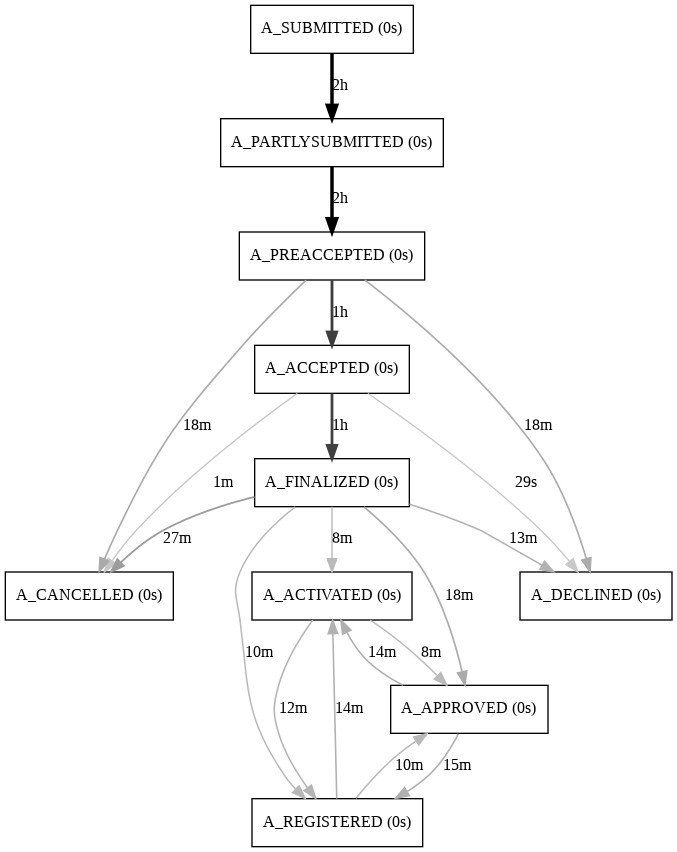

In [239]:

dfg = dfg_discovery.apply(application_log_filtered)
gviz = dfg_visualization.apply(dfg, log=application_log_filtered, variant=dfg_visualization.Variants.PERFORMANCE,)
dfg_visualization.view(gviz)

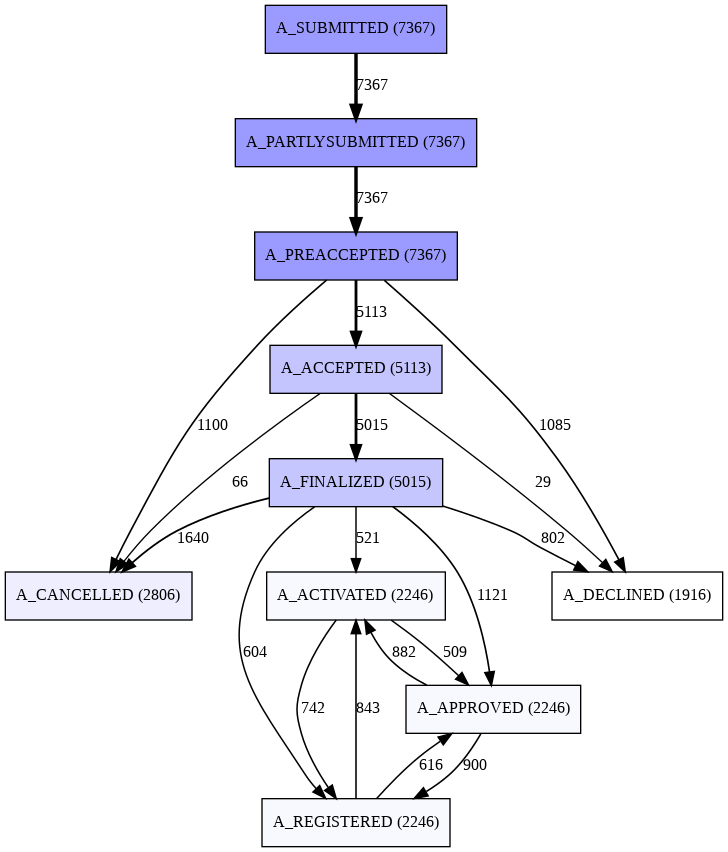

In [240]:

dfg = dfg_discovery.apply(application_log_filtered)
gviz = dfg_visualization.apply(dfg, log=application_log_filtered, variant=dfg_visualization.Variants.FREQUENCY)
dfg_visualization.view(gviz)

# Offer Sub Process (OSP) Analyzes

In [241]:
# Profiling offer sub process
offer_profile = offer_df.groupby('case:concept:name').agg(
Activity = ('concept:name', 'count'),\
Activity_list = ('concept:name', lambda x: ','.join(x) ),\
Resource = ('org:resource', 'nunique'),\
Duration = ('time:timestamp', lambda x: x.max()- x.min()),\
)

In [242]:
# Analysis on offer sub process
offer_log = pm4py.convert_to_event_log(offer_df)

# Number of cases
print("Number of cases : ",len(offer_log))

# Number of events
offer_df = pm4py.convert_to_dataframe(offer_log)
print("Number of events :",len(offer_df))

# First Timestamp
first = offer_df['time:timestamp'].min()
print(first)

# Last Timestamp
last = offer_df['time:timestamp'].max()
print(last)

# Mean Duration with out 0 day
mean_offer_df = offer_profile['Duration'].agg('mean')
print('mean = ', mean_offer_df)

# Mean Duration with 0 day
mean_offer_df_filtered = offer_profile[(offer_profile['Duration'] > np.timedelta64(25, 'h'))].agg('mean')
print('mean with 0 day filtered = ', mean_offer_df_filtered)

# Number of types
offer_types = offer_df['concept:name'].nunique()
print("Number of types :",offer_types)

# Number of resource
number_resources = offer_df['org:resource'].nunique()
print("Number of resources = ",number_resources)

Number of cases :  5015
Number of events : 31244
2011-10-01 08:44:40.725000+00:00
2012-03-14 14:50:59.683000+00:00
mean =  17 days 04:20:24.846146959
mean with 0 day filtered =  Activity                      6.336122
Resource                      2.826187
Duration    18 days 00:27:56.279726417
dtype: object
Number of types : 7
Number of resources =  60


/usr/local/lib/python3.7/dist-packages/pandas/core/apply.py:577: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  return f(*args, **kwargs)


In [243]:
#Variant Analysis on OSP
# Extract the variants from the event log
variants = variants_filter.get_variants(offer_log)
variants

{'O_SELECTED,O_CREATED,O_SENT': [{'attributes': {'REG_DATE': Timestamp('2012-02-10 12:45:49.643000+0000', tz='UTC'), 'concept:name': '208097', 'AMOUNT_REQ': '5000'}, 'events': [{'org:resource': '10935', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'O_SELECTED', 'time:timestamp': Timestamp('2012-02-13 10:50:51.407000+0000', tz='UTC'), 'case:REG_DATE': Timestamp('2012-02-10 12:45:49.643000+0000', tz='UTC'), 'case:concept:name': '208097', 'case:AMOUNT_REQ': '5000'}, '..', {'org:resource': '10935', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'O_SENT', 'time:timestamp': Timestamp('2012-02-13 10:50:52.917000+0000', tz='UTC'), 'case:REG_DATE': Timestamp('2012-02-10 12:45:49.643000+0000', tz='UTC'), 'case:concept:name': '208097', 'case:AMOUNT_REQ': '5000'}]},
  {'attributes': {'REG_DATE': Timestamp('2012-02-12 16:11:55.720000+0000', tz='UTC'), 'concept:name': '208610', 'AMOUNT_REQ': '5000'}, 'events': [{'org:resource': '10909', 'lifecycle:transition': 'COMPLETE', 'concept:name':

In [244]:
len(variants)

166

In [245]:
variants_count = case_statistics.get_variant_statistics(offer_log)
variants_count

[{'count': 1537,
  'variant': 'O_SELECTED,O_CREATED,O_SENT,O_SENT_BACK,O_ACCEPTED'},
 {'count': 1132, 'variant': 'O_SELECTED,O_CREATED,O_SENT,O_CANCELLED'},
 {'count': 574,
  'variant': 'O_SELECTED,O_CREATED,O_SENT,O_SENT_BACK,O_DECLINED'},
 {'count': 173,
  'variant': 'O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELECTED,O_CREATED,O_SENT,O_SENT_BACK,O_ACCEPTED'},
 {'count': 168,
  'variant': 'O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELECTED,O_CREATED,O_SENT,O_CANCELLED'},
 {'count': 151, 'variant': 'O_SELECTED,O_CREATED,O_SENT'},
 {'count': 145,
  'variant': 'O_SELECTED,O_CREATED,O_SENT,O_SELECTED,O_CANCELLED,O_CREATED,O_SENT,O_SENT_BACK,O_ACCEPTED'},
 {'count': 126,
  'variant': 'O_SELECTED,O_CREATED,O_SENT,O_SELECTED,O_CANCELLED,O_CREATED,O_SENT,O_CANCELLED'},
 {'count': 90,
  'variant': 'O_SELECTED,O_CREATED,O_SENT,O_SENT_BACK,O_CANCELLED'},
 {'count': 72,
  'variant': 'O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELECTED,O_CREATED,O_SENT,O_SENT_BACK,O_DECLINED'},
 {'count': 66,
  'v

In [246]:
len(variants_count)

166

In [247]:
# Convert from event data to dataframe in pandas
variants_df = pd.DataFrame.from_records(variants_count)
variants_df

,variant,count
0,"O_SELECTED,O_CREATED,O_SENT,O_SENT_BACK,O_ACCE...",1537
1,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED",1132
2,"O_SELECTED,O_CREATED,O_SENT,O_SENT_BACK,O_DECL...",574
3,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELE...",173
4,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELE...",168
...,...,...
161,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELE...",1
162,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELE...",1
163,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELE...",1
164,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELE...",1


In [248]:
# Top 5 variants
variants_df.head(5)

,variant,count
0,"O_SELECTED,O_CREATED,O_SENT,O_SENT_BACK,O_ACCE...",1537
1,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED",1132
2,"O_SELECTED,O_CREATED,O_SENT,O_SENT_BACK,O_DECL...",574
3,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELE...",173
4,"O_SELECTED,O_CREATED,O_SENT,O_CANCELLED,O_SELE...",168


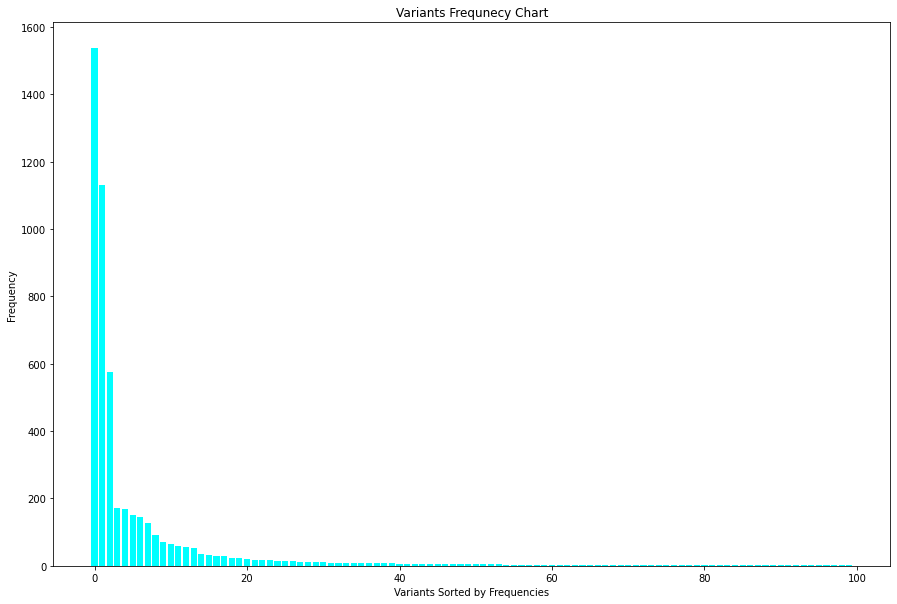

In [249]:
# Prepare the dimensions to plot
# Put variants and counts into lists of prefered length
variant = variants_df[0:100].index
frequency = variants_df[0:100]['count']


# Return a list of log values from a list
#frequency_log = [math.log(i, 2) for i in frequency]

# Plot a histogram of the frequencies
fig = plt.figure(figsize = (15,10))


# Creating the step plot
plt.bar(variant, frequency, color= 'aqua')
plt.xlabel("Variants Sorted by Frequencies")
plt.ylabel("Frequency")
plt.title("Variants Frequnecy Chart")
plt.savefig('Variants_Frequency_OSP.png')
plt.show()

In [250]:
incomplete_offers = 0
accpeted_offers= 0
answered_offers = 0
created_offers = 0

for variant in variants_count:
    if "O_ACCEPTED" not in variant['variant']:
      accpeted_offers += variant['count']
    if 'O_SENT_BACK' in variant['variant']:
      answered_offers += variant['count']

    if 'O_CREATED' in variant['variant']:
      created_offers += variant['count']
    if "O_CANCELLED" not in variant['variant'] and "O_ACCEPTED" not in variant['variant'] and "O_DECLINED" not in variant['variant']:
        incomplete_offers +=variant['count']

print("Created Offers: ",created_offers)
print("Accepted Offers : ", accpeted_offers)
print("Answered Offers = ", answered_offers)
print("Incomplete Offers",incomplete_offers)


Created Offers:  5015
Accepted Offers :  2772
Answered Offers =  3254
Incomplete Offers 211


In [251]:
activities = pm4py.get_event_attribute_values(offer_df, "concept:name")

In [252]:
activities

{'O_ACCEPTED': 2243,
 'O_CANCELLED': 3655,
 'O_CREATED': 7030,
 'O_DECLINED': 802,
 'O_SELECTED': 7030,
 'O_SENT': 7030,
 'O_SENT_BACK': 3454}

In [253]:
# Filter by start activities
start_activites = pm4py.get_start_activities(offer_df)
start_activities_df = pd.DataFrame.from_dict(start_activites,orient='index',columns = ["Count"])
start_activities_df

,Count
O_SELECTED,5015


In [254]:
# Filter by end activities
end_activities = pm4py.get_end_activities(offer_df)
end_activities_df = pd.DataFrame.from_dict(end_activities,orient='index',columns = ["Count"])
end_activities_df

,Count
O_ACCEPTED,2243
O_CANCELLED,1640
O_DECLINED,802
O_SENT,241
O_SENT_BACK,89


In [258]:
k = 5
offer_log_filtered = pm4py.filter_variants_top_k(offer_log, k)

In [338]:
len(offer_log)

5015

In [340]:
len(offer_log_filtered)

3584

In [259]:
# Process Discover

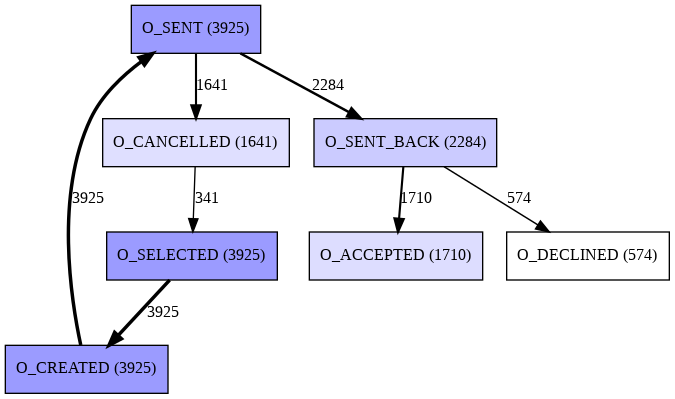

In [260]:
## Import the dfg_discovery algorithm
from pm4py.algo.discovery.dfg import algorithm as dfg_discovery_algorithm

## Import the dfg visualization object
from pm4py.visualization.dfg import visualizer as dfg_visualization

# Create graph from event log
dfg = dfg_discovery_algorithm.apply(offer_log_filtered)

# Visualise
gviz = dfg_visualization.apply(dfg, log=offer_log_filtered, variant=dfg_visualization.Variants.FREQUENCY)
dfg_visualization.view(gviz)

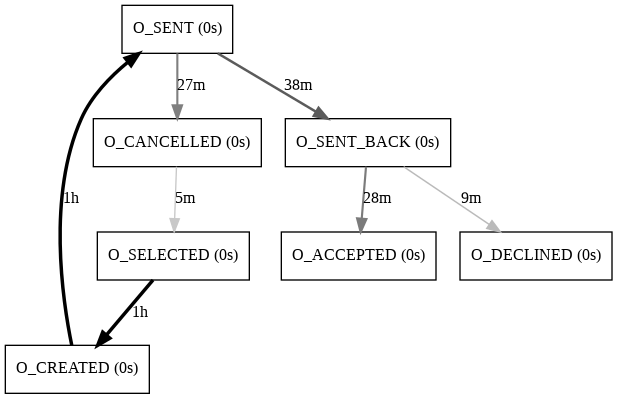

In [261]:
## Import the dfg_discovery algorithm
from pm4py.algo.discovery.dfg import algorithm as dfg_discovery_algorithm

## Import the dfg visualization object
from pm4py.visualization.dfg import visualizer as dfg_visualization

# Create graph from event log
dfg = dfg_discovery_algorithm.apply(offer_log_filtered)

# Visualise
gviz = dfg_visualization.apply(dfg, log=offer_log_filtered, variant=dfg_visualization.Variants.PERFORMANCE)
dfg_visualization.view(gviz)

In [262]:
# Alpha Miner

In [263]:
net, initial_marking, final_marking = alpha_miner.apply(offer_log_filtered)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  


replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

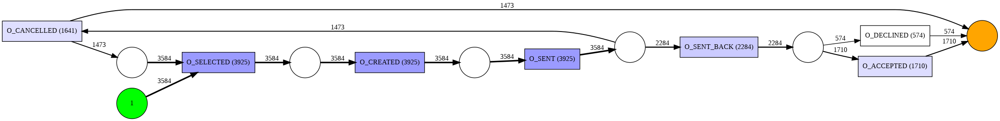

In [264]:
# Visualise 
gviz = pn_visualizer.apply(net, initial_marking, final_marking, variant=pn_visualizer.Variants.FREQUENCY, parameters={alpha_miner.Variants.ALPHA_VERSION_CLASSIC.value.Parameters.START_TIMESTAMP_KEY:'0:0:0'}, log=offer_log_filtered)
pn_visualizer.view(gviz)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  


replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

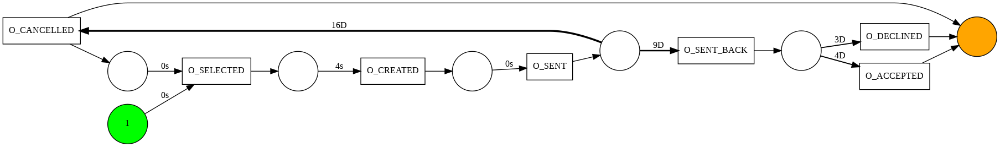

In [265]:
# Visualise 
gviz = pn_visualizer.apply(net, initial_marking, final_marking, variant=pn_visualizer.Variants.PERFORMANCE, log=offer_log_filtered)
pn_visualizer.view(gviz)

In [266]:
# Conformance Checking for Alpha Miner

In [268]:
# Fitness
offer_alpha_fitness = replay_fitness_evaluator.apply(offer_log_filtered, net, initial_marking, final_marking, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)
# Precision
offer_alpha_precision = precision_evaluator.apply(offer_log_filtered, net, initial_marking, final_marking, variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
# Generalization
offer_alpha_generalization = generalization_evaluator.apply(offer_log_filtered, net, initial_marking, final_marking)
# Simplicity
offer_alpha_simplicity = simplicity_evaluator.apply(net)

print("Fitness for offer sub process alpha :",offer_alpha_fitness)
print("Precision for offer sub process alpha :",offer_alpha_precision)
print("Generalization for offer sub process alpha :",offer_alpha_generalization)
print("Simplicity for offer sub process alpha :",offer_alpha_simplicity)


replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/9 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

Fitness for offer sub process alpha : {'perc_fit_traces': 0.0, 'average_trace_fitness': 0.8905473943839162, 'log_fitness': 0.887665418480969, 'percentage_of_fitting_traces': 0.0}
Precision for offer sub process alpha : 1.0
Generalization for offer sub process alpha : 0.9772261411440892
Simplicity for offer sub process alpha : 0.7777777777777779


In [269]:
# Inductive Miner

In [270]:
# Inductive Miner Using Tree

In [271]:
tree = inductive_miner.apply_tree(offer_log_filtered)

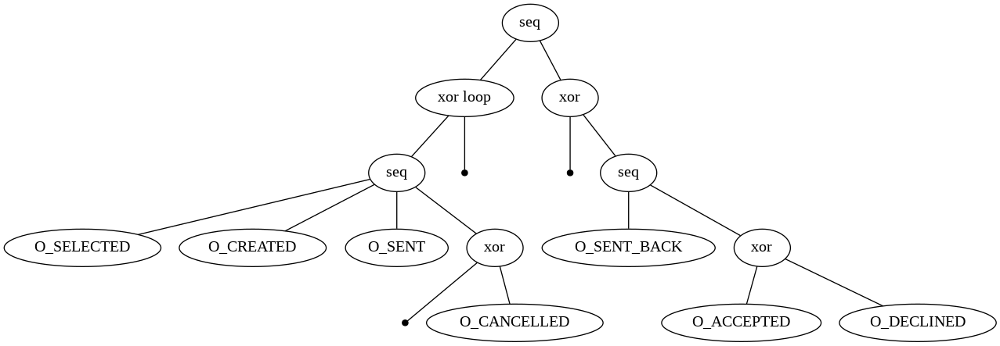

In [272]:
gviz = pt_visualizer.apply(tree, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})
pt_visualizer.view(gviz)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  


replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

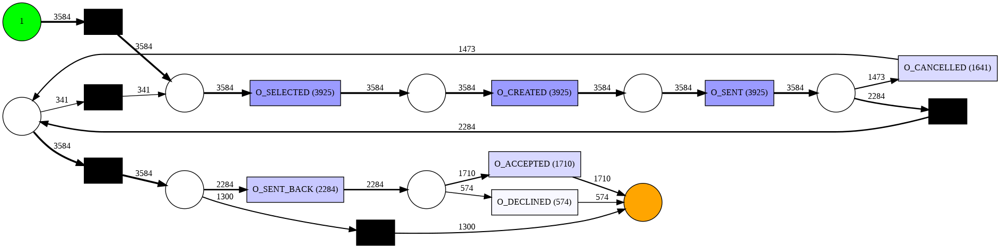

In [275]:
# Tree to Petri-net
net, initial_marking, final_marking = pt_converter.apply(tree)
## Then visualise
gviz = pn_visualizer.apply(net, initial_marking, final_marking, 
                           variant=pn_visualizer.Variants.FREQUENCY, 
                           log=offer_log_filtered,parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})
pn_visualizer.view(gviz)

In [78]:
# Conformance Checking for Inductive Miner

In [276]:
# Fitness
offer_inductive_fitness = replay_fitness_evaluator.apply(offer_log_filtered, net, initial_marking, final_marking, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)
# Precision
offer_inductive_precision = precision_evaluator.apply(offer_log_filtered, net, initial_marking, final_marking, variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
# Generalization
offer_inductive_generalization = generalization_evaluator.apply(offer_log_filtered, net, initial_marking, final_marking)
# Simplicity
offer_inductive_simplicity = simplicity_evaluator.apply(net)


print("Fitness of inductive for offer sub process :",offer_inductive_fitness)
print("Precision of inductive for offer sub process :",offer_inductive_precision)
print("Generalization of inductive for offer sub process :",offer_inductive_generalization)
print("Simplicity of inductive for offer sub process :",offer_inductive_simplicity)

replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/9 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

Fitness of inductive for offer sub process : {'perc_fit_traces': 100.0, 'average_trace_fitness': 1.0, 'log_fitness': 1.0, 'percentage_of_fitting_traces': 100.0}
Precision of inductive for offer sub process : 0.8440212235145297
Generalization of inductive for offer sub process : 0.975363578173749
Simplicity of inductive for offer sub process : 0.7777777777777779


In [277]:
# Conformance Cheking
# Token-based replay matches a trace and a Petri net model,
# Alignment-based replay aims to find one of the best alignment between the trace and the model.

from pm4py.algo.conformance.tokenreplay import algorithm as token_replay
from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments

# Token-based replay matches a trace and a Petri net model,

replayed_traces = token_replay.apply(offer_log, net, initial_marking, final_marking)


print("REPLAY")
print("Number of traces", len(replayed_traces))
#print(replayed_traces)

#print("Case", event_log[0].attributes['concept:name'])

anomalous_traces = []
i = 0
while i < len(replayed_traces):
	if replayed_traces[i]["trace_fitness"] < 1:
		anomalous_traces.append(offer_log[i].attributes["concept:name"])
	i += 1
# print the list as a string
print(', '.join(map(str, anomalous_traces)))
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(replayed_traces))*100 , '%')

# Alignment-based replay aims to find one of the best alignment between the trace and the model.

aligned_traces = alignments.apply_log(offer_log, net, initial_marking, final_marking)

print("ALIGNMENTS")
print("Number of traces", len(aligned_traces))

#print(aligned_traces)

anomalous_traces = []
i = 0
while i < len(aligned_traces):
	if aligned_traces[i]["fitness"] != 1:
		anomalous_traces.append(offer_log[i].attributes["concept:name"])
		#anomalous_traces.append(aligned_traces[i]['alignment'])
	i += 1
# print the list as a string
#print(', '.join(map(str, anomalous_traces)))
print(anomalous_traces)
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(aligned_traces))*100 , '%')

replaying log with TBR, completed variants ::   0%|          | 0/166 [00:00<?, ?it/s]

REPLAY
Number of traces 5015
173718, 173736, 173748, 173880, 174060, 174012, 174096, 174069, 174036, 174132, 174168, 174337, 174294, 174349, 174358, 174382, 174099, 174436, 174502, 174511, 174159, 174644, 174722, 174758, 174761, 174815, 174863, 174872, 174671, 174707, 174985, 175015, 175060, 174944, 175093, 174764, 174650, 175254, 175281, 175329, 175428, 175651, 175892, 175913, 175804, 175958, 175883, 175807, 175735, 175741, 175997, 176090, 176119, 176093, 176182, 175726, 176281, 176290, 176287, 176368, 176383, 176380, 176374, 176446, 176345, 176428, 176488, 176575, 176714, 176539, 176813, 176792, 176840, 176921, 176960, 176891, 176981, 177011, 176765, 177053, 177077, 177170, 177323, 177299, 177471, 177519, 177221, 177263, 177603, 177083, 177624, 177579, 177618, 177669, 176611, 177690, 177776, 177827, 177908, 177675, 177516, 178110, 178119, 178179, 178203, 178245, 178302, 177995, 178392, 178419, 177971, 178590, 178620, 178278, 178656, 178644, 178780, 178816, 178804, 178689, 178843, 178

aligning log, completed variants ::   0%|          | 0/166 [00:00<?, ?it/s]

ALIGNMENTS
Number of traces 5015
['173718', '173736', '173748', '173880', '174060', '174012', '174096', '174069', '174036', '174132', '174168', '174337', '174294', '174349', '174358', '174382', '174099', '174436', '174502', '174511', '174159', '174644', '174722', '174758', '174761', '174815', '174863', '174872', '174671', '174707', '174985', '175015', '175060', '174944', '175093', '174764', '174650', '175254', '175281', '175329', '175428', '175651', '175892', '175913', '175804', '175958', '175883', '175807', '175735', '175741', '175997', '176090', '176119', '176093', '176182', '175726', '176281', '176290', '176287', '176368', '176383', '176380', '176374', '176446', '176345', '176428', '176488', '176575', '176714', '176539', '176813', '176792', '176840', '176921', '176960', '176891', '176981', '177011', '176765', '177053', '177077', '177170', '177323', '177299', '177471', '177519', '177221', '177263', '177603', '177083', '177624', '177579', '177618', '177669', '176611', '177690', '17777

In [81]:
# Heuristic Miner

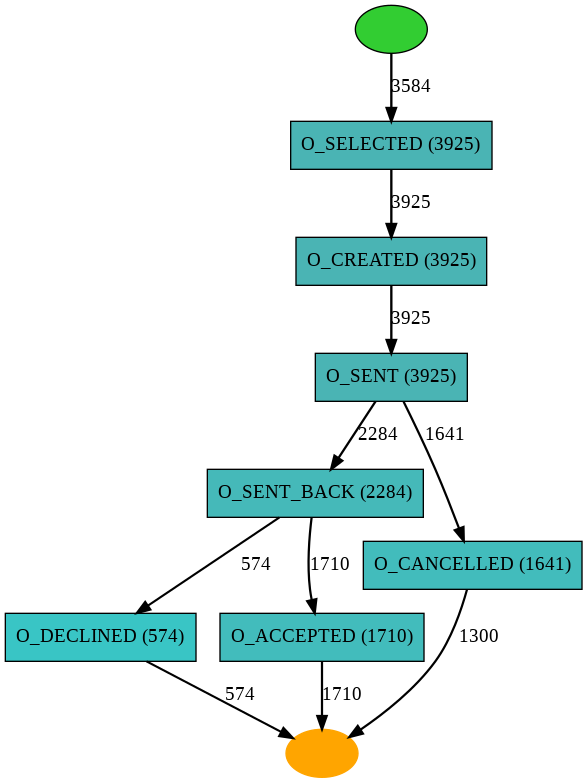

In [278]:
net = heuristics_miner.apply_heu(offer_log_filtered, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.998})
gviz = hn_visualizer.apply(net)
hn_visualizer.view(gviz)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  after removing the cwd from sys.path.


replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

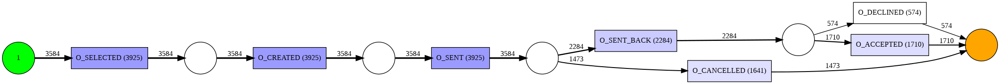

In [279]:
# Visualize Heuristic as Petri-net
net, initial_marking, final_marking = heuristics_miner.apply(offer_log_filtered, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.998})

gviz = pn_visualizer.apply(net, initial_marking, final_marking, variant=pn_visualizer.Variants.FREQUENCY, log=offer_log_filtered)
pn_visualizer.view(gviz)

In [84]:
# Conformance Checking for Heuristic Miner


In [280]:
# Fitness
offer_heuristic_fitness = replay_fitness_evaluator.apply(offer_log_filtered, net, initial_marking, final_marking, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)
# Precision
offer_heuristic_precision = precision_evaluator.apply(offer_log_filtered, net, initial_marking, final_marking, variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
# Generalization
offer_heuristic_generalization = generalization_evaluator.apply(offer_log_filtered, net, initial_marking, final_marking)
# Simplicity
offer_heuristic_simplicity = simplicity_evaluator.apply(net)

print("Fitness of heuristic for offer sub process :",offer_heuristic_fitness)
print("Precision of heuristic for offer sub process :",offer_heuristic_precision)
print("Generalization of heuristic for offer sub process :",offer_heuristic_generalization)
print("Simplicity of heuristic for offer sub process :",offer_heuristic_simplicity)

replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/9 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/5 [00:00<?, ?it/s]

Fitness of heuristic for offer sub process : {'perc_fit_traces': 90.48549107142857, 'average_trace_fitness': 0.9899646577380902, 'log_fitness': 0.9841895400593472, 'percentage_of_fitting_traces': 90.48549107142857}
Precision of heuristic for offer sub process : 1.0
Generalization of heuristic for offer sub process : 0.9772261411440892
Simplicity of heuristic for offer sub process : 0.8666666666666667


In [281]:
# Conformance Cheking
# Token-based replay matches a trace and a Petri net model,
# Alignment-based replay aims to find one of the best alignment between the trace and the model.

from pm4py.algo.conformance.tokenreplay import algorithm as token_replay
from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments

# Token-based replay matches a trace and a Petri net model,

replayed_traces = token_replay.apply(offer_log, net, initial_marking, final_marking)


print("REPLAY")
print("Number of traces", len(replayed_traces))
#print(replayed_traces)

#print("Case", event_log[0].attributes['concept:name'])

anomalous_traces = []
i = 0
while i < len(replayed_traces):
	if replayed_traces[i]["trace_fitness"] < 1:
		anomalous_traces.append(offer_log[i].attributes["concept:name"])
	i += 1
# print the list as a string
print(', '.join(map(str, anomalous_traces)))
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(replayed_traces))*100 , '%')

# Alignment-based replay aims to find one of the best alignment between the trace and the model.

aligned_traces = alignments.apply_log(offer_log, net, initial_marking, final_marking)

print("ALIGNMENTS")
print("Number of traces", len(aligned_traces))

#print(aligned_traces)

anomalous_traces = []
i = 0
while i < len(aligned_traces):
	if aligned_traces[i]["fitness"] != 1:
		anomalous_traces.append(offer_log[i].attributes["concept:name"])
		#anomalous_traces.append(aligned_traces[i]['alignment'])
	i += 1
# print the list as a string
#print(', '.join(map(str, anomalous_traces)))
print(anomalous_traces)
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(aligned_traces))*100 , '%')

replaying log with TBR, completed variants ::   0%|          | 0/166 [00:00<?, ?it/s]

REPLAY
Number of traces 5015
173718, 173691, 173736, 173748, 173787, 173817, 173694, 173880, 174060, 174012, 173928, 174096, 174141, 174069, 174036, 174132, 174168, 174216, 174180, 174337, 174294, 174349, 173949, 174367, 174358, 174382, 174264, 174099, 174436, 174409, 174502, 174511, 174159, 174644, 174659, 174478, 174722, 174758, 174761, 174815, 174863, 174872, 174671, 174884, 174707, 174935, 174985, 174965, 175015, 175060, 174944, 175078, 175093, 175105, 174764, 174650, 175275, 175177, 175254, 175323, 175281, 175329, 175231, 175395, 175410, 175428, 175543, 175491, 175497, 175585, 175651, 175892, 175913, 175804, 175801, 175958, 175883, 175807, 175735, 175780, 175741, 175997, 176105, 176090, 176119, 176093, 176182, 176203, 175726, 176281, 176290, 176287, 176368, 176383, 176380, 176374, 176305, 176446, 176345, 176428, 176491, 176488, 176575, 176714, 176539, 176672, 176813, 176792, 176840, 176921, 176960, 176891, 176981, 176996, 177011, 176533, 176765, 177053, 177077, 177170, 177323, 177

aligning log, completed variants ::   0%|          | 0/166 [00:00<?, ?it/s]

ALIGNMENTS
Number of traces 5015
['173718', '173691', '173736', '173748', '173787', '173817', '173694', '173880', '174060', '174012', '173928', '174096', '174141', '174069', '174036', '174132', '174168', '174216', '174180', '174337', '174294', '174349', '173949', '174367', '174358', '174382', '174264', '174099', '174436', '174409', '174502', '174511', '174159', '174644', '174659', '174478', '174722', '174758', '174761', '174815', '174863', '174872', '174671', '174884', '174707', '174935', '174985', '174965', '175015', '175060', '174944', '175078', '175093', '175105', '174764', '174650', '175275', '175177', '175254', '175323', '175281', '175329', '175231', '175395', '175410', '175428', '175543', '175491', '175497', '175585', '175651', '175892', '175913', '175804', '175801', '175958', '175883', '175807', '175735', '175780', '175741', '175997', '176105', '176090', '176119', '176093', '176182', '176203', '175726', '176281', '176290', '176287', '176368', '176383', '176380', '176374', '17630

In [282]:
len(offer_log_filtered)

3584

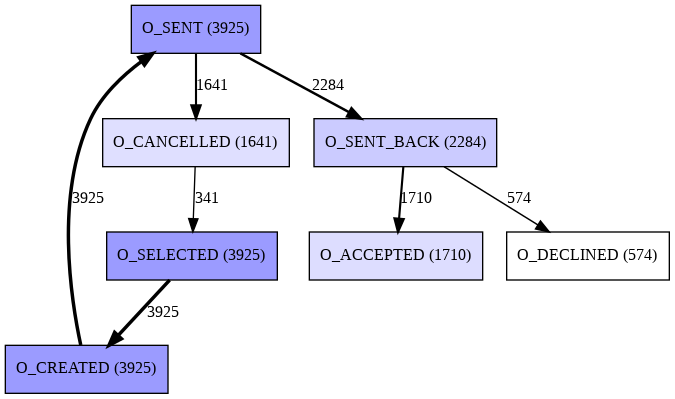

In [283]:
dfg = dfg_discovery.apply(offer_log_filtered)
gviz = dfg_visualization.apply(dfg, log=offer_log_filtered, variant=dfg_visualization.Variants.FREQUENCY, parameters={dfg_visualization.Variants.FREQUENCY.value.Parameters.MAX_NO_EDGES_IN_DIAGRAM:10})
dfg_visualization.view(gviz)

# Work Item Sub Process (WISP) Analyzes

In [284]:
workItem_log = pm4py.convert_to_event_log(workItem_df)

In [285]:
# Profiling offer sub process
wi_profile = workItem_df.groupby('case:concept:name').agg(
Activity = ('concept:name', 'count'),\
Activity_list = ('concept:name', lambda x: ','.join(x) ),\
Resource = ('org:resource', 'nunique'),\
Duration = ('time:timestamp', lambda x: x.max()- x.min()),\
)

In [286]:
# Analysis on offer sub process

# Number of cases
print("Number of cases : ",len(workItem_log))

# Number of events
print("Number of events :",len(workItem_df))

# First Timestamp
first = workItem_df['time:timestamp'].min()
print(first)

# Last Timestamp
last = workItem_df['time:timestamp'].max()
print(last)

# Mean Duration with out 0 day
mean_workItem_df = wi_profile['Duration'].agg('mean')
print('mean = ', mean_workItem_df)

# Mean Duration with 0 day
mean_workItem_df_filtered = wi_profile[(wi_profile['Duration'] > np.timedelta64(25, 'h'))].agg('mean')
print('mean with 0 day filtered = ', mean_workItem_df_filtered)

# Number of types
workItem_types = workItem_df['concept:name'].nunique()
print("Number of types :",workItem_types)

# Number of resource
number_resources = workItem_df['org:resource'].nunique()
print("Number of resources = ",number_resources)

Number of cases :  9658
Number of events : 170107
2011-09-30 22:39:38.875000+00:00
2012-03-14 15:04:54.681000+00:00
mean =  11 days 16:26:31.640076517
mean with 0 day filtered =  Activity                     24.622368
Resource                        6.9306
Duration    17 days 20:54:58.011957562
dtype: object
Number of types : 7
Number of resources =  59


/usr/local/lib/python3.7/dist-packages/pandas/core/apply.py:577: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  return f(*args, **kwargs)


In [287]:
#Variant Analysis on ASP
# Extract the variants from the event log
variants = variants_filter.get_variants(workItem_log)
variants

{'W_Completeren aanvraag,W_Completeren aanvraag,W_Nabellen offertes,W_Completeren aanvraag,W_Nabellen offertes,W_Nabellen offertes,W_Nabellen offertes,W_Nabellen offertes,W_Nabellen offertes,W_Valideren aanvraag,W_Nabellen offertes,W_Valideren aanvraag,W_Valideren aanvraag': [{'attributes': {'REG_DATE': Timestamp('2011-09-30 22:38:44.546000+0000', tz='UTC'), 'concept:name': '173688', 'AMOUNT_REQ': '20000'}, 'events': [{'org:resource': '112', 'lifecycle:transition': 'SCHEDULE', 'concept:name': 'W_Completeren aanvraag', 'time:timestamp': Timestamp('2011-09-30 22:39:38.875000+0000', tz='UTC')}, '..', {'org:resource': '10629', 'lifecycle:transition': 'COMPLETE', 'concept:name': 'W_Valideren aanvraag', 'time:timestamp': Timestamp('2011-10-13 08:37:37.026000+0000', tz='UTC')}]},
  {'attributes': {'REG_DATE': Timestamp('2011-10-01 13:15:17.454000+0000', tz='UTC'), 'concept:name': '173760', 'AMOUNT_REQ': '32000'}, 'events': [{'org:resource': '112', 'lifecycle:transition': 'SCHEDULE', 'concept:

In [288]:
len(variants)

2643

In [289]:
variants_count = case_statistics.get_variant_statistics(workItem_log)

variants_count

[{'count': 1872,
  'variant': 'W_Afhandelen leads,W_Afhandelen leads,W_Afhandelen leads'},
 {'count': 316,
  'variant': 'W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag'},
 {'count': 277,
  'variant': 'W_Afhandelen leads,W_Afhandelen leads,W_Completeren aanvraag,W_Afhandelen leads,W_Completeren aanvraag,W_Completeren aanvraag'},
 {'count': 271,
  'variant': 'W_Afhandelen leads,W_Afhandelen leads,W_Afhandelen leads,W_Afhandelen leads,W_Afhandelen leads'},
 {'count': 196,
  'variant': 'W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag'},
 {'count': 160,
  'variant': 'W_Afhandelen leads,W_Afhandelen leads,W_Completeren aanvraag,W_Afhandelen leads,W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag'},
 {'count': 115,
  'variant': 'W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag,W_Completeren aanvraag

In [94]:
len(variants_count)

2643

In [290]:
# Convert from event data to dataframe in pandas
variants_df = pd.DataFrame.from_records(variants_count)
variants_df

,variant,count
0,"W_Afhandelen leads,W_Afhandelen leads,W_Afhand...",1872
1,"W_Completeren aanvraag,W_Completeren aanvraag,...",316
2,"W_Afhandelen leads,W_Afhandelen leads,W_Comple...",277
3,"W_Afhandelen leads,W_Afhandelen leads,W_Afhand...",271
4,"W_Completeren aanvraag,W_Completeren aanvraag,...",196
...,...,...
2638,"W_Afhandelen leads,W_Afhandelen leads,W_Afhand...",1
2639,"W_Afhandelen leads,W_Afhandelen leads,W_Afhand...",1
2640,"W_Afhandelen leads,W_Afhandelen leads,W_Afhand...",1
2641,"W_Afhandelen leads,W_Afhandelen leads,W_Afhand...",1


In [291]:
# Top 5 variants
variants_df.head(5)

,variant,count
0,"W_Afhandelen leads,W_Afhandelen leads,W_Afhand...",1872
1,"W_Completeren aanvraag,W_Completeren aanvraag,...",316
2,"W_Afhandelen leads,W_Afhandelen leads,W_Comple...",277
3,"W_Afhandelen leads,W_Afhandelen leads,W_Afhand...",271
4,"W_Completeren aanvraag,W_Completeren aanvraag,...",196


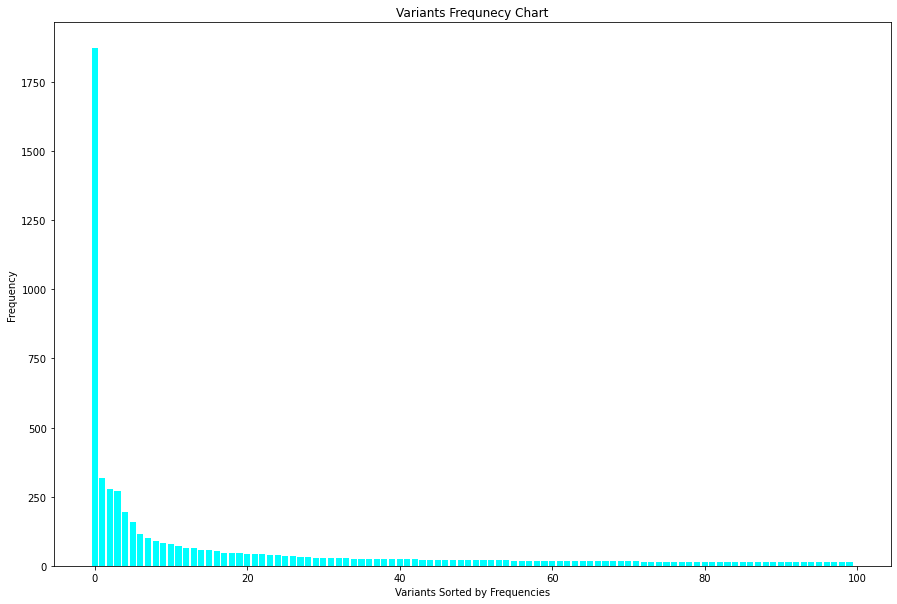

In [293]:
# Prepare the dimensions to plot
# Put variants and counts into lists of prefered length
variant = variants_df[0:100].index
frequency = variants_df[0:100]['count']


# Return a list of log values from a list
frequency_log = [math.log(i, 2) for i in frequency]

# Plot a histogram of the frequencies
fig = plt.figure(figsize = (15,10))


# Creating the step plot
plt.bar(variant, frequency, color= 'aqua')
plt.xlabel("Variants Sorted by Frequencies")
plt.ylabel("Frequency")
plt.title("Variants Frequnecy Chart")
plt.savefig('Variants_Frequency_WISP.png')
plt.show()

In [294]:
activities = pm4py.get_event_attribute_values(workItem_df, "concept:name")

In [295]:
activities

{'W_Afhandelen leads': 16566,
 'W_Beoordelen fraude': 664,
 'W_Completeren aanvraag': 54850,
 'W_Nabellen incomplete dossiers': 25190,
 'W_Nabellen offertes': 52016,
 'W_Valideren aanvraag': 20809,
 'W_Wijzigen contractgegevens': 12}

In [296]:
# Filter by start activities
start_activites = pm4py.get_start_activities(workItem_df)
start_activities_df = pd.DataFrame.from_dict(start_activites,orient='index',columns = ["Count"])
start_activities_df

,Count
W_Completeren aanvraag,4852
W_Afhandelen leads,4739
W_Beoordelen fraude,67


In [297]:
# Filter by end activities
end_activities = pm4py.get_end_activities(workItem_df)
end_activities_df = pd.DataFrame.from_dict(end_activities,orient='index',columns = ["Count"])
end_activities_df

,Count
W_Valideren aanvraag,2749
W_Completeren aanvraag,2355
W_Afhandelen leads,2235
W_Nabellen offertes,1802
W_Nabellen incomplete dossiers,456
W_Beoordelen fraude,57
W_Wijzigen contractgegevens,4


In [336]:
len(workItem_log)

9658

In [314]:
k = 200
workItem_log_filtered = pm4py.filter_variants_top_k(workItem_log, k)

In [337]:
len(workItem_log_filtered)

6475

In [102]:
# Process Discovery

In [103]:
# Alpha Miner

In [316]:
net, initial_marking, final_marking = alpha_miner.apply(workItem_log_filtered)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  


replaying log with TBR, completed variants ::   0%|          | 0/200 [00:00<?, ?it/s]

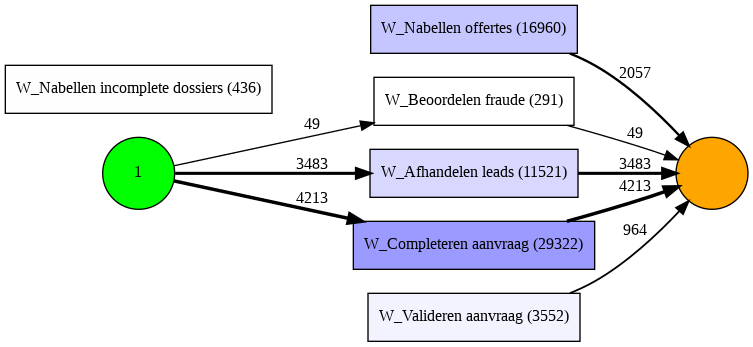

In [317]:
# Visualise 
gviz = pn_visualizer.apply(net, initial_marking, final_marking, variant=pn_visualizer.Variants.FREQUENCY, parameters={alpha_miner.Variants.ALPHA_VERSION_CLASSIC.value.Parameters.START_TIMESTAMP_KEY:'0:0:0'}, log=workItem_log_filtered)
pn_visualizer.view(gviz)

In [318]:
# Conformance Checking for Alpha Miner

In [320]:
# Fitness
wi_alpha_fitness = replay_fitness_evaluator.apply(workItem_log_filtered, net, initial_marking, final_marking, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)
# Precision
wi_alpha_precision = precision_evaluator.apply(workItem_log_filtered, net, initial_marking, final_marking, variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
# Generalization
wi_alpha_generalization = generalization_evaluator.apply(workItem_log_filtered, net, initial_marking, final_marking)
# Simplicity

wi_alpha_simplicity = simplicity_evaluator.apply(net)

print("Fitness for work item sub process alpha :",wi_alpha_fitness)
print("Precision for work item sub process alpha :",wi_alpha_precision)
print("Generalization for work item sub process alpha :",wi_alpha_generalization)
print("Simplicity for work item sub process alpha :",wi_alpha_simplicity)


replaying log with TBR, completed variants ::   0%|          | 0/200 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/441 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/200 [00:00<?, ?it/s]

Fitness for work item sub process alpha : {'perc_fit_traces': 0.0, 'average_trace_fitness': 0.3271773971733772, 'log_fitness': 0.23105514934237292, 'percentage_of_fitting_traces': 0.0}
Precision for work item sub process alpha : 0.33333333333333337
Generalization for work item sub process alpha : 0.9756456068873451
Simplicity for work item sub process alpha : 1.0


In [ ]:
# Inductive Miner

In [ ]:
# Inductive Miner Using Tree

In [322]:
tree = inductive_miner.apply_tree(workItem_log_filtered)

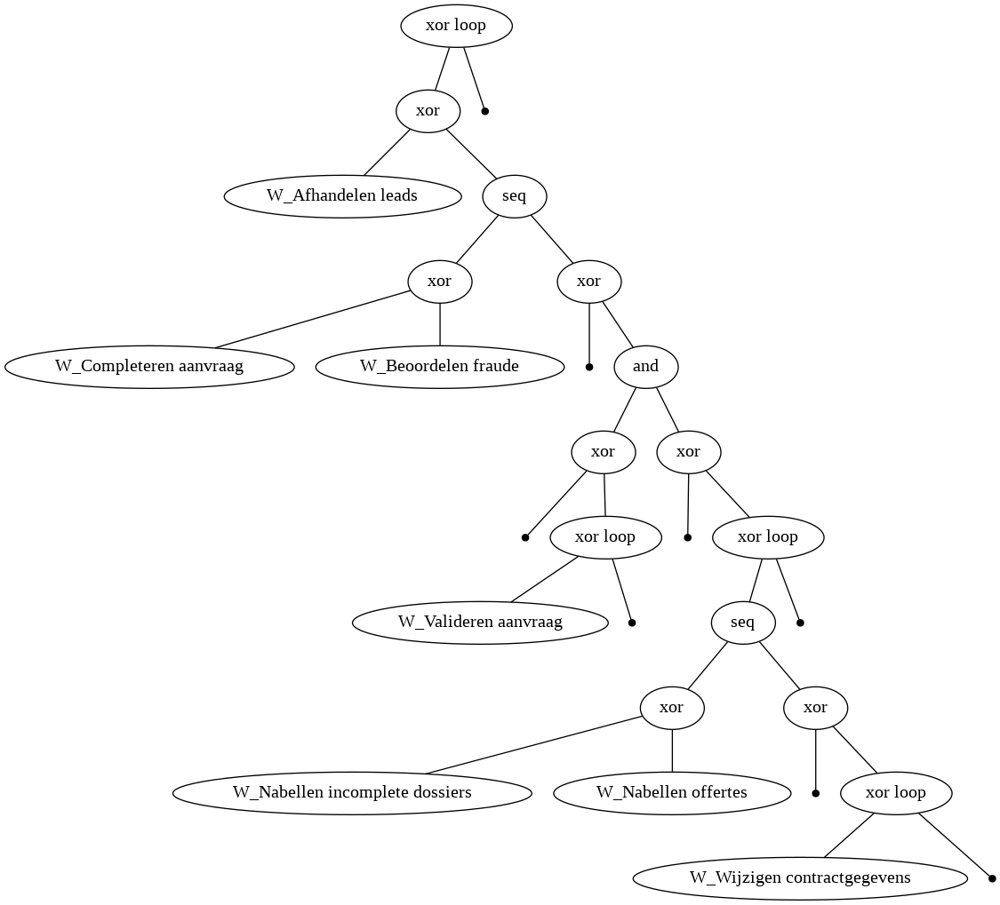

In [ ]:
gviz = pt_visualizer.apply(tree, parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})
pt_visualizer.view(gviz)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  


replaying log with TBR, completed variants ::   0%|          | 0/200 [00:00<?, ?it/s]

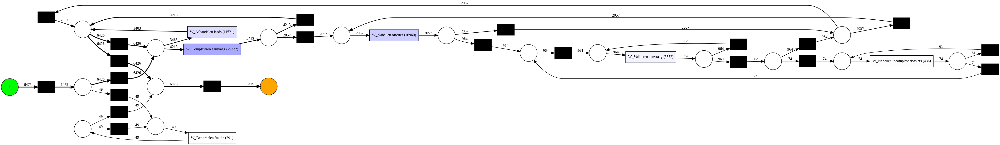

In [323]:
# Tree to Petri-net
net, initial_marking, final_marking = pt_converter.apply(tree)
## Then visualise
gviz = pn_visualizer.apply(net, initial_marking, final_marking, 
                           variant=pn_visualizer.Variants.FREQUENCY, 
                           log=workItem_log_filtered,parameters={pt_visualizer.Variants.WO_DECORATION.value.Parameters.FORMAT: "png"})
pn_visualizer.view(gviz)

In [ ]:
# Conformance Checking for Inductive Miner

In [325]:
# Fitness
wi_inductive_fitness = replay_fitness_evaluator.apply(workItem_log_filtered, net, initial_marking, final_marking, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)
# Precision
wi_inductive_precision = precision_evaluator.apply(workItem_log_filtered, net, initial_marking, final_marking, variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
# Generalization
wi_inductive_generalization = generalization_evaluator.apply(workItem_log_filtered, net, initial_marking, final_marking)
# Simplicity
wi_inductive_simplicity = simplicity_evaluator.apply(net)


print("Fitness of inductive for work item sub process :",wi_inductive_fitness)
print("Precision of inductive for work item sub process :",wi_inductive_precision)
print("Generalization of inductive for work item sub process :",wi_inductive_generalization)
print("Simplicity of inductive for work item sub process :",wi_inductive_simplicity)

replaying log with TBR, completed variants ::   0%|          | 0/200 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/441 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/200 [00:00<?, ?it/s]

Fitness of inductive for work item sub process : {'perc_fit_traces': 100.0, 'average_trace_fitness': 1.0, 'log_fitness': 1.0, 'percentage_of_fitting_traces': 100.0}
Precision of inductive for work item sub process : 0.493050375264512
Generalization of inductive for work item sub process : 0.9657868331957135
Simplicity of inductive for work item sub process : 0.7142857142857143


In [326]:
# Conformance Cheking
# Token-based replay matches a trace and a Petri net model,
# Alignment-based replay aims to find one of the best alignment between the trace and the model.

from pm4py.algo.conformance.tokenreplay import algorithm as token_replay
from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments

# Token-based replay matches a trace and a Petri net model,

replayed_traces = token_replay.apply(workItem_log, net, initial_marking, final_marking)


print("REPLAY")
print("Number of traces", len(replayed_traces))
#print(replayed_traces)

#print("Case", event_log[0].attributes['concept:name'])

anomalous_traces = []
i = 0
while i < len(replayed_traces):
	if replayed_traces[i]["trace_fitness"] < 1:
		anomalous_traces.append(workItem_log[i].attributes["concept:name"])
	i += 1
# print the list as a string
print(', '.join(map(str, anomalous_traces)))
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(replayed_traces))*100 , '%')

# Alignment-based replay aims to find one of the best alignment between the trace and the model.

aligned_traces = alignments.apply_log(workItem_log, net, initial_marking, final_marking)

print("ALIGNMENTS")
print("Number of traces", len(aligned_traces))

#print(aligned_traces)

anomalous_traces = []
i = 0
while i < len(aligned_traces):
	if aligned_traces[i]["fitness"] != 1:
		anomalous_traces.append(workItem_log[i].attributes["concept:name"])
		#anomalous_traces.append(aligned_traces[i]['alignment'])
	i += 1
# print the list as a string
#print(', '.join(map(str, anomalous_traces)))
print(anomalous_traces)
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(aligned_traces))*100 , '%')

replaying log with TBR, completed variants ::   0%|          | 0/2643 [00:00<?, ?it/s]

REPLAY
Number of traces 9658
173721, 173754, 173955, 174036, 174084, 174168, 174237, 174337, 174382, 174436, 174478, 174650, 174719, 174761, 174764, 174785, 174815, 174872, 175015, 175027, 175254, 175329, 175428, 175597, 175651, 175735, 175883, 175994, 176287, 176326, 176374, 176380, 176539, 176542, 176575, 176714, 176792, 176813, 176891, 176921, 177083, 177206, 177263, 177471, 177624, 177776, 177821, 177995, 178122, 178245, 178278, 178392, 178518, 178590, 178722, 178804, 179029, 179293, 179384, 179423, 179501, 179519, 179579, 179646, 179673, 179899, 180004, 180070, 180313, 180481, 180628, 180637, 180685, 180718, 180808, 180914, 181055, 181073, 181121, 181231, 181348, 181396, 181541, 181655, 181709, 181912, 181957, 181981, 182155, 182242, 182281, 182293, 182299, 182407, 182533, 182581, 182647, 182726, 182831, 182894, 182903, 182927, 182963, 183052, 183064, 183121, 183151, 183169, 183175, 183232, 183247, 183250, 183405, 184168, 184189, 184213, 184598, 184784, 184955, 184991, 185045, 185

aligning log, completed variants ::   0%|          | 0/2643 [00:00<?, ?it/s]

ALIGNMENTS
Number of traces 9658
['173694', '173721', '173754', '173955', '174036', '174084', '174168', '174237', '174337', '174382', '174436', '174478', '174650', '174719', '174761', '174764', '174785', '174815', '174872', '175015', '175027', '175254', '175329', '175428', '175597', '175651', '175735', '175756', '175883', '175994', '176287', '176326', '176374', '176380', '176539', '176542', '176575', '176714', '176792', '176813', '176891', '176921', '177083', '177206', '177263', '177471', '177624', '177776', '177821', '177995', '178122', '178245', '178278', '178392', '178518', '178590', '178722', '178804', '178843', '179029', '179293', '179384', '179423', '179501', '179519', '179579', '179646', '179673', '179899', '180004', '180070', '180313', '180481', '180628', '180637', '180685', '180718', '180808', '180914', '181055', '181073', '181121', '181231', '181348', '181396', '181447', '181541', '181655', '181709', '181912', '181957', '181981', '182155', '182242', '182281', '182293', '18229

In [327]:
# Heuristic Miner

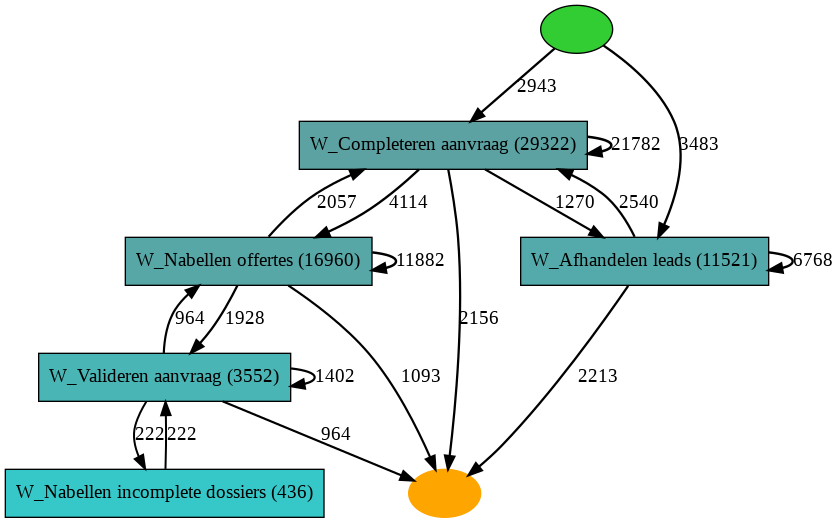

In [329]:

net = heuristics_miner.apply_heu(workItem_log_filtered, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.999})


gviz = hn_visualizer.apply(net)
hn_visualizer.view(gviz)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DeprecatedWarning: apply is deprecated as of 2.2.5 and will be removed in 3.0.0. please use pm4py.visualization.petri_net.algorithm instead
  after removing the cwd from sys.path.


replaying log with TBR, completed variants ::   0%|          | 0/200 [00:00<?, ?it/s]

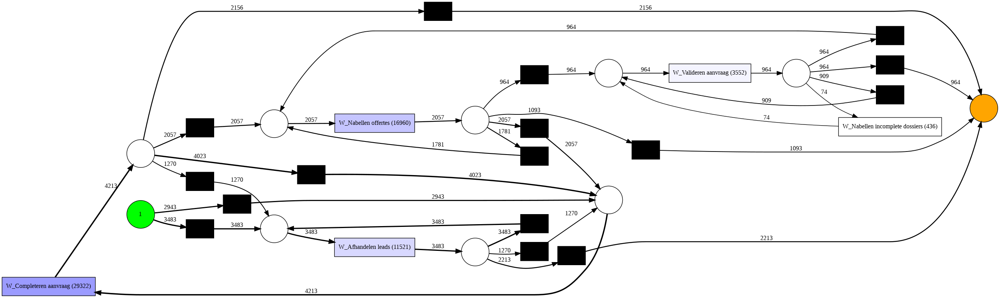

In [330]:
# Visualize Heuristic as Petri-net
net, initial_marking, final_marking = heuristics_miner.apply(workItem_log_filtered, parameters={heuristics_miner.Variants.CLASSIC.value.Parameters.DEPENDENCY_THRESH: 0.999})

gviz = pn_visualizer.apply(net, initial_marking, final_marking, variant=pn_visualizer.Variants.FREQUENCY, log=workItem_log_filtered)
pn_visualizer.view(gviz)

In [331]:
# Conformance Checking for Heuristic Miner


In [332]:
# Fitness
wi_heuristic_fitness = replay_fitness_evaluator.apply(workItem_log_filtered, net, initial_marking, final_marking, variant=replay_fitness_evaluator.Variants.TOKEN_BASED)
# Precision
wi_heuristic_precision = precision_evaluator.apply(workItem_log_filtered, net, initial_marking, final_marking, variant=precision_evaluator.Variants.ETCONFORMANCE_TOKEN)
# Generalization
wi_heuristic_generalization = generalization_evaluator.apply(workItem_log_filtered, net, initial_marking, final_marking)
# Simplicity
wi_heuristic_simplicity = simplicity_evaluator.apply(net)

print("Fitness of heuristic for work item sub process :",wi_heuristic_fitness)
print("Precision of heuristic for work item sub process :",wi_heuristic_precision)
print("Generalization of heuristic for work item sub process :",wi_heuristic_generalization)
print("Simplicity of heuristic for work item sub process :",wi_heuristic_simplicity)

replaying log with TBR, completed variants ::   0%|          | 0/200 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/441 [00:00<?, ?it/s]

replaying log with TBR, completed variants ::   0%|          | 0/200 [00:00<?, ?it/s]

Fitness of heuristic for work item sub process : {'perc_fit_traces': 98.3011583011583, 'average_trace_fitness': 0.9913864456375114, 'log_fitness': 0.9980628148846528, 'percentage_of_fitting_traces': 98.3011583011583}
Precision of heuristic for work item sub process : 0.532950423216445
Generalization of heuristic for work item sub process : 0.9798062284144449
Simplicity of heuristic for work item sub process : 0.5849056603773586


In [333]:
# Conformance Cheking
# Token-based replay matches a trace and a Petri net model,
# Alignment-based replay aims to find one of the best alignment between the trace and the model.

from pm4py.algo.conformance.tokenreplay import algorithm as token_replay
from pm4py.algo.conformance.alignments.petri_net import algorithm as alignments

# Token-based replay matches a trace and a Petri net model,

replayed_traces = token_replay.apply(workItem_log, net, initial_marking, final_marking)


print("REPLAY")
print("Number of traces", len(replayed_traces))
#print(replayed_traces)

#print("Case", event_log[0].attributes['concept:name'])

anomalous_traces = []
i = 0
while i < len(replayed_traces):
	if replayed_traces[i]["trace_fitness"] < 1:
		anomalous_traces.append(workItem_log[i].attributes["concept:name"])
	i += 1
# print the list as a string
print(', '.join(map(str, anomalous_traces)))
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(replayed_traces))*100 , '%')

# Alignment-based replay aims to find one of the best alignment between the trace and the model.

aligned_traces = alignments.apply_log(workItem_log, net, initial_marking, final_marking)

print("ALIGNMENTS")
print("Number of traces", len(aligned_traces))

#print(aligned_traces)

anomalous_traces = []
i = 0
while i < len(aligned_traces):
	if aligned_traces[i]["fitness"] != 1:
		anomalous_traces.append(workItem_log[i].attributes["concept:name"])
		#anomalous_traces.append(aligned_traces[i]['alignment'])
	i += 1
# print the list as a string
#print(', '.join(map(str, anomalous_traces)))
print(anomalous_traces)
print("Number of anomalous traces ", len(anomalous_traces))

print("Percentage of anomalous traces", (len(anomalous_traces)/len(aligned_traces))*100 , '%')

replaying log with TBR, completed variants ::   0%|          | 0/2643 [00:00<?, ?it/s]

REPLAY
Number of traces 9658
173718, 173721, 173730, 173736, 173739, 173784, 173880, 173916, 173928, 173940, 173955, 174036, 174042, 174045, 174060, 174069, 174084, 174096, 174132, 174168, 174216, 174237, 174252, 174261, 174264, 174285, 174325, 174337, 174343, 174358, 174382, 174397, 174409, 174418, 174424, 174436, 174448, 174463, 174478, 174559, 174577, 174650, 174656, 174659, 174734, 174755, 174758, 174761, 174764, 174785, 174815, 174824, 174845, 174851, 174872, 174896, 174923, 174926, 174935, 174944, 175000, 175015, 175078, 175081, 175147, 175180, 175192, 175204, 175248, 175254, 175281, 175293, 175311, 175329, 175335, 175353, 175374, 175377, 175392, 175410, 175425, 175428, 175437, 175543, 175549, 175582, 175597, 175651, 175684, 175735, 175822, 175859, 175883, 175892, 175994, 176048, 176087, 176090, 176093, 176134, 176167, 176176, 176218, 176239, 176287, 176290, 176326, 176374, 176380, 176383, 176386, 176404, 176446, 176467, 176488, 176515, 176539, 176542, 176566, 176575, 176581, 176

aligning log, completed variants ::   0%|          | 0/2643 [00:00<?, ?it/s]

ALIGNMENTS
Number of traces 9658
['173694', '173718', '173721', '173730', '173736', '173739', '173754', '173784', '173880', '173916', '173928', '173940', '173955', '174036', '174042', '174045', '174060', '174069', '174084', '174096', '174132', '174168', '174216', '174237', '174252', '174261', '174264', '174285', '174325', '174337', '174343', '174358', '174382', '174397', '174409', '174418', '174424', '174436', '174448', '174463', '174478', '174559', '174577', '174650', '174656', '174659', '174719', '174734', '174755', '174758', '174761', '174764', '174785', '174815', '174824', '174845', '174851', '174872', '174896', '174923', '174926', '174935', '174944', '175000', '175015', '175027', '175078', '175081', '175147', '175180', '175192', '175204', '175248', '175254', '175281', '175293', '175311', '175329', '175335', '175353', '175374', '175377', '175392', '175410', '175425', '175428', '175437', '175543', '175549', '175582', '175597', '175651', '175684', '175735', '175756', '175822', '17585

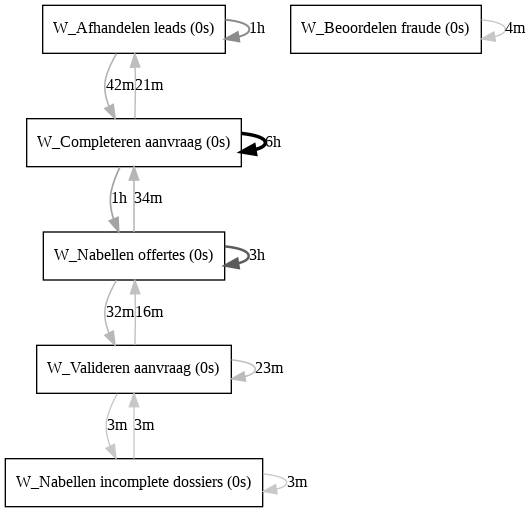

In [334]:

dfg = dfg_discovery.apply(workItem_log_filtered)
gviz = dfg_visualization.apply(dfg, log=workItem_log, variant=dfg_visualization.Variants.PERFORMANCE)
dfg_visualization.view(gviz)

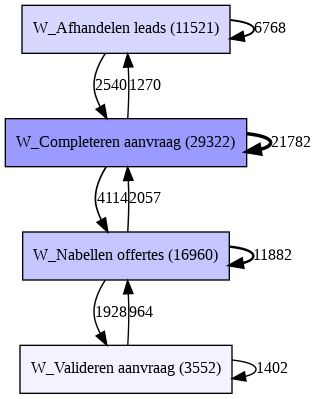

In [335]:

dfg = dfg_discovery.apply(workItem_log_filtered)
gviz = dfg_visualization.apply(dfg, log=workItem_log_filtered, variant=dfg_visualization.Variants.FREQUENCY, parameters={dfg_visualization.Variants.FREQUENCY.value.Parameters.MAX_NO_EDGES_IN_DIAGRAM:10})
dfg_visualization.view(gviz)

# DFG on General Log

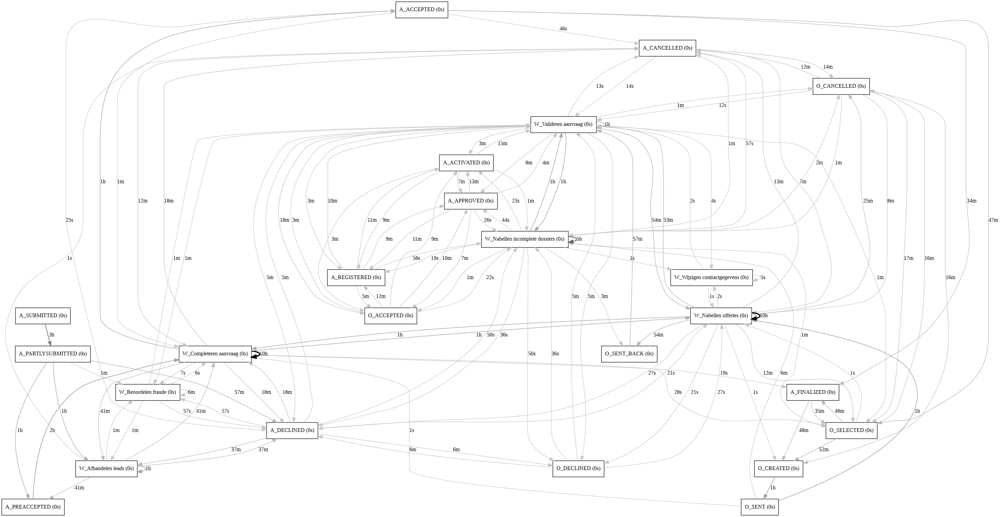

In [135]:

dfg_general = dfg_discovery.apply(log)


from pm4py.visualization.dfg import visualizer as dfg_visualization

gviz_general = dfg_visualization.apply(dfg_general, log=log, variant=dfg_visualization.Variants.PERFORMANCE)
dfg_visualization.view(gviz_general)